<a href="https://colab.research.google.com/github/escuccim/pytorch-face-autoencoder/blob/master/eas7_faces_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Adding some longer residual connections to try to preserve some small details which seem to be getting lost; added batch norm; replaced 6x5 convolution with global average pool followed by 1x1 convolution.

In [0]:
import torch
import torchvision
from torch.utils.data import DataLoader
from matplotlib import pyplot as plt
%matplotlib inline
import zipfile
import os

In [0]:
from google.colab import auth
auth.authenticate_user()

In [3]:
# upload checkpoint to GCS
project_id = 'mammography-198911'
bucket_name = 'pneumonia'

!gcloud config set project {project_id}

Updated property [core/project].


To take a quick anonymous survey, run:
  $ gcloud alpha survey



In [4]:
!gsutil cp gs://{bucket_name}/model_30.pt ./model_3.pt

Copying gs://pneumonia/model_30.pt...
\ [1 files][294.9 MiB/294.9 MiB]                                                
Operation completed over 1 objects/294.9 MiB.                                    


In [5]:
if not os.path.exists("celeba-dataset.zip"):
#   !kaggle datasets download -d jessicali9530/celeba-dataset
  !gsutil cp gs://{bucket_name}/celeba-dataset.zip ./celeba-dataset.zip
  zip_ref = zipfile.ZipFile('celeba-dataset.zip', 'r')
  zip_ref.extractall('data')
  zip_ref.close()

  zip_ref = zipfile.ZipFile('data/img_align_celeba.zip', 'r')
  zip_ref.extractall('data/images')
  zip_ref.close()

Copying gs://pneumonia/celeba-dataset.zip...
- [1 files][  1.2 GiB/  1.2 GiB]  102.2 MiB/s                                   
Operation completed over 1 objects/1.2 GiB.                                      


In [6]:
if not os.path.exists("Training_Pictures.zip"):
  !wget https://s3.eu-west-3.amazonaws.com/deep.skoo.ch/Training_Pictures.zip
  zip_ref = zipfile.ZipFile('Training_Pictures.zip', 'r')
  zip_ref.extractall('data/images')
  zip_ref.close()

--2019-05-24 05:26:56--  https://s3.eu-west-3.amazonaws.com/deep.skoo.ch/Training_Pictures.zip
Resolving s3.eu-west-3.amazonaws.com (s3.eu-west-3.amazonaws.com)... 52.95.156.49
Connecting to s3.eu-west-3.amazonaws.com (s3.eu-west-3.amazonaws.com)|52.95.156.49|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1073596 (1.0M) [application/zip]
Saving to: ‘Training_Pictures.zip’

Training_Pictures.z 100%[===================>]   1.02M  1.66MB/s    in 0.6s    

2019-05-24 05:26:57 (1.66 MB/s) - ‘Training_Pictures.zip’ saved [1073596/1073596]



In [7]:
if not os.path.exists("wiki_images2.zip"):
  !gsutil cp gs://{bucket_name}/wiki_images2.zip ./wiki_images.zip
  zip_ref = zipfile.ZipFile('wiki_images.zip', 'r')
  zip_ref.extractall('data/images')
  zip_ref.close()
  
if not os.path.exists("imdb_images3.zip"):
  !gsutil cp gs://{bucket_name}/imdb_images3.zip ./imdb_images3.zip
  zip_ref = zipfile.ZipFile('imdb_images3.zip', 'r')
  zip_ref.extractall('data/images')
  zip_ref.close()    

Copying gs://pneumonia/wiki_images2.zip...
/ [1 files][160.5 MiB/160.5 MiB]                                                
Operation completed over 1 objects/160.5 MiB.                                    
Copying gs://pneumonia/imdb_images3.zip...
- [1 files][  1.5 GiB/  1.5 GiB]   99.8 MiB/s                                   
Operation completed over 1 objects/1.5 GiB.                                      


In [8]:
# get test data
if not os.path.exists("faces94.zip"):
  !wget https://cswww.essex.ac.uk/mv/allfaces/faces94.zip
  zip_ref = zipfile.ZipFile('faces94.zip', 'r')
  zip_ref.extractall('data/test_images')
  zip_ref.close()
  
if not os.path.exists("faces96.zip"):
  !wget https://cswww.essex.ac.uk/mv/allfaces/faces96.zip  
  zip_ref = zipfile.ZipFile('faces96.zip', 'r')
  zip_ref.extractall('data/test_images')
  zip_ref.close()
  
if not os.path.exists("faces95.zip"):
  !wget https://cswww.essex.ac.uk/mv/allfaces/faces95.zip  
  zip_ref = zipfile.ZipFile('faces95.zip', 'r')
  zip_ref.extractall('data/test_images')
  zip_ref.close()
  
if not os.path.exists("GWB_200x200_JPEG.zip"):
  !wget https://s3.eu-west-3.amazonaws.com/deep.skoo.ch/GWB_200x200_JPEG.zip
  zip_ref = zipfile.ZipFile('GWB_200x200_JPEG.zip', 'r')
  zip_ref.extractall('data/test_images')
  zip_ref.close()    

if not os.path.exists("crop_part1.tar.gz"):
  !gsutil cp gs://{bucket_name}/crop_part1.tar.gz ./crop_part1.tar.gz
  !tar -xf crop_part1.tar.gz -C data/test_images

--2019-05-24 05:28:15--  https://cswww.essex.ac.uk/mv/allfaces/faces94.zip
Resolving cswww.essex.ac.uk (cswww.essex.ac.uk)... 155.245.92.179
Connecting to cswww.essex.ac.uk (cswww.essex.ac.uk)|155.245.92.179|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 18845407 (18M) [application/zip]
Saving to: ‘faces94.zip’

faces94.zip         100%[===================>]  17.97M  13.5MB/s    in 1.3s    

2019-05-24 05:28:17 (13.5 MB/s) - ‘faces94.zip’ saved [18845407/18845407]

--2019-05-24 05:28:21--  https://cswww.essex.ac.uk/mv/allfaces/faces96.zip
Resolving cswww.essex.ac.uk (cswww.essex.ac.uk)... 155.245.92.179
Connecting to cswww.essex.ac.uk (cswww.essex.ac.uk)|155.245.92.179|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 21040168 (20M) [application/zip]
Saving to: ‘faces96.zip’

faces96.zip         100%[===================>]  20.07M  13.8MB/s    in 1.5s    

2019-05-24 05:28:22 (13.8 MB/s) - ‘faces96.zip’ saved [21040168/21040168]

--2019

In [0]:
BATCH_SIZE = 48
data_path = "data/images"

transform = torchvision.transforms.Compose(
    [torchvision.transforms.RandomHorizontalFlip(p=0.5), 
      torchvision.transforms.RandomApply([
        torchvision.transforms.RandomAffine(degrees=5, translate=(0.05,0.05), scale=(0.9,1.1), shear=2, resample=False, fillcolor=0),        
      ], 0.6),
      torchvision.transforms.RandomResizedCrop((192,160), scale=(0.85, 1.15)),
      torchvision.transforms.ToTensor(),
    ])

transform2 = torchvision.transforms.Compose(
    [torchvision.transforms.RandomResizedCrop((192,160), scale=(0.95, 1.05)),
      torchvision.transforms.ToTensor(),
    ])

train_dataset = torchvision.datasets.ImageFolder(
        root=data_path,
        transform=transform
    )

train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    num_workers=2,
    shuffle=True
)

test_dataset = torchvision.datasets.ImageFolder(
        root="data/test_images",
        transform=transform2
    )

test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=32,
    num_workers=1,
    shuffle=True
)

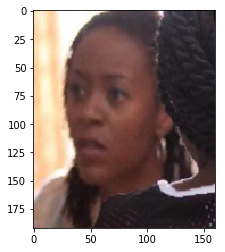

In [10]:
for (images, _) in train_loader:
  plt.imshow(images[0].permute(1,2,0))
  plt.show()
  break

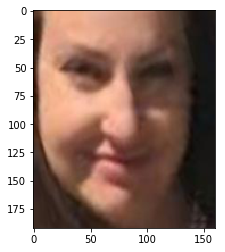

In [11]:
for (images, _) in test_loader:
  plt.imshow(images[0].permute(1,2,0))
  plt.show()
  break

In [12]:
train_dataset

Dataset ImageFolder
    Number of datapoints: 393640
    Root Location: data/images
    Transforms (if any): Compose(
                             RandomHorizontalFlip(p=0.5)
                             RandomApply(
                             p=0.6
                             RandomAffine(degrees=(-5, 5), translate=(0.05, 0.05), scale=(0.9, 1.1), shear=(-2, 2))
                         )
                             RandomResizedCrop(size=(192, 160), scale=(0.85, 1.15), ratio=(0.75, 1.3333), interpolation=PIL.Image.BILINEAR)
                             ToTensor()
                         )
    Target Transforms (if any): None

In [13]:
test_dataset

Dataset ImageFolder
    Number of datapoints: 17799
    Root Location: data/test_images
    Transforms (if any): Compose(
                             RandomResizedCrop(size=(192, 160), scale=(0.95, 1.05), ratio=(0.75, 1.3333), interpolation=PIL.Image.BILINEAR)
                             ToTensor()
                         )
    Target Transforms (if any): None

In [0]:
def output_size(i, k=3, p=2, s=1, d=1):
    o = (i + 2*p - k - (k-1)*(d-1))/s + 1
    return o
  
output_size(i=64, k=3, p=1)

64.0

### Bigger Model

In [0]:
epoch_list = []

In [0]:
def vae_loss(x, x_hat, mu=None, logvar=None):
    MSE = nn.functional.mse_loss(x, x_hat)
    
    if mu is not None and logvar is not None:
      KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
      KLD /= BATCH_SIZE * 784
      MSE = MSE + KLD
      
    return MSE
  
def train(model, train_loader, optimizer, test_loader=None, print_metrics=1000, plot_images=4000, num_epochs=10, display_images=5, scheduler=None, save_path="model_3.pt"):
    try:
      for epoch in range(num_epochs):
          model.train()
          upload_path = save_path.split(".")[0] + str(len(epoch_list) % 2) + ".pt" 
          
          tr_loss = 0.0
          test_loss = 0
          batch_losses = []
          for i, (inputs, _) in enumerate(train_loader):
              if use_cuda and torch.cuda.is_available():
                  inputs = inputs.cuda()

              optimizer.zero_grad()

              recon, code, logvar = model(inputs)
              if model.variational:
                  loss = vae_loss(inputs, recon, code, logvar=logvar)
              else:  
                  loss = vae_loss(inputs, recon, code, logvar=None)

              loss.backward()
              optimizer.step()

              tr_loss += loss.item()
              batch_losses.append(loss.item())
            
              if i > 0 and print_metrics != 0 and i % print_metrics == 0:
                print("\tEpoch", len(epoch_list), "batch", i, "loss:", loss.item())

              if i % plot_images == 0 and i > 0:
                fig, ax = plt.subplots(1, 2, figsize=(6,6))
                ax[0].imshow(inputs[0].cpu().permute(1, 2, 0) )
                ax[1].imshow(recon[0].cpu().detach().permute(1, 2, 0) )
                plt.show()
          
          if epoch % display_images == 0:
              # plot a few random images
              try:
                fig, ax = plt.subplots(2, 2, figsize=(6,6))
                fig.suptitle("Training Images")
                ax[0,0].imshow(inputs[0].cpu().permute(1, 2, 0) )
                ax[0,1].imshow(recon[0].cpu().detach().permute(1, 2, 0) )
                ax[1,0].imshow(inputs[1].cpu().permute(1, 2, 0) )
                ax[1,1].imshow(recon[1].cpu().detach().permute(1, 2, 0) )
                plt.show()
              except Exception as e:
                  print(e)

              torch.save(model.state_dict(), save_path)
#               !gsutil cp ./model.pt gs://{bucket_name}/
          
          if test_loader is not None:
            model.eval()
            with torch.no_grad():
              for i, (inputs, _) in enumerate(test_loader):
                if use_cuda and torch.cuda.is_available():
                    inputs = inputs.cuda()

                recon, code, logvar = model(inputs)

                if model.variational:
                    loss = vae_loss(inputs, recon, code, logvar=logvar)
                else:  
                    loss = vae_loss(inputs, recon, code, logvar=None)

                test_loss += loss.item()

            try:
                fig, ax = plt.subplots(2, 2, figsize=(7,7))
                fig.suptitle("Test Images")
                ax[0,0].imshow(inputs[0].cpu().permute(1, 2, 0) )
                ax[0,1].imshow(recon[0].cpu().detach().permute(1, 2, 0) )
                ax[1,0].imshow(inputs[1].cpu().permute(1, 2, 0) )
                ax[1,1].imshow(recon[1].cpu().detach().permute(1, 2, 0) )
                plt.show()
            except Exception as e:
                print(e)
                  
          print("Epoch:", len(epoch_list), "Train Loss:", tr_loss, "Test Loss:", test_loss)
          
          epoch_list.append(epoch)
          
          if scheduler is not None and epoch % 5 == 0 and epoch > 1:
              scheduler.step()

                
    except KeyboardInterrupt:
      print("Interrupting... Saving model...")
      torch.save(model.state_dict(), save_path)
      !gsutil cp {save_path} gs://{bucket_name}/{upload_path}
      return 
    
    !gsutil cp {save_path} gs://{bucket_name}/{upload_path}
    
def count_params(model):
  model_parameters = filter(lambda p: p.requires_grad, model.parameters())
  params = sum([np.prod(p.size()) for p in model_parameters])
  return params                

In [0]:
from torch import nn
class Encoder(nn.Module):
    def __init__(self, latent_dim, variational=False):
        super(Encoder, self).__init__()
        # block 1
        self.conv1 = nn.Conv2d(3, 32, 3, padding=1)
        self.bn1 = nn.BatchNorm2d(32)
        self.conv2 = nn.Conv2d(32, 32, 3, padding=1)        
        self.bn2 = nn.BatchNorm2d(32)
        self.conv3 = nn.Conv2d(32, 32, 3, padding=1)
        self.bn3 = nn.BatchNorm2d(32)
        self.downsize1 = nn.Conv2d(96, 32, 1)
        self.bn_ds1 = nn.BatchNorm2d(32)
        
        # block 2
        self.conv4 = nn.Conv2d(32, 64, 3, padding=1)
        self.bn4 = nn.BatchNorm2d(64)
        self.conv5 = nn.Conv2d(64, 64, 3, padding=1)
        self.bn5 = nn.BatchNorm2d(64)
        self.conv6 = nn.Conv2d(64, 64, 3, padding=1)
        self.bn6 = nn.BatchNorm2d(64)
        self.downsize2 = nn.Conv2d(192, 64, 1)
        self.bn_ds2 = nn.BatchNorm2d(64)
        
        # block 3
        self.conv7 = nn.Conv2d(64, 128, 3, padding=1)
        self.bn7 = nn.BatchNorm2d(128)
        self.conv8 = nn.Conv2d(128, 128, 3, padding=1)
        self.bn8 = nn.BatchNorm2d(128)
        self.conv9 = nn.Conv2d(128, 128, 3, padding=1)
        self.bn9 = nn.BatchNorm2d(128)
        self.downsize3 = nn.Conv2d(384, 128, 1)
        self.bn_ds3 = nn.BatchNorm2d(128)
        
        # block 4
        self.conv10 = nn.Conv2d(128, 256, 3, padding=1)
        self.bn10 = nn.BatchNorm2d(256)
        self.conv11 = nn.Conv2d(256, 256, 3, padding=1)
        self.bn11 = nn.BatchNorm2d(256)
        self.downsize4 = nn.Conv2d(512, 256, 1)
        self.bn_ds4 = nn.BatchNorm2d(256)
        
        # block 5
        self.conv12 = nn.Conv2d(256, 384, 3, padding=1)
        self.bn12 = nn.BatchNorm2d(384)
        self.conv13 = nn.Conv2d(384, 384, 3, padding=1)
        self.bn13 = nn.BatchNorm2d(384)
        self.downsize5 = nn.Conv2d(768, 384, 1)
        self.bn_ds5 = nn.BatchNorm2d(384)
        
        # second path - skip from block 2 on
        self.conv14 = nn.Conv2d(64, 128, 3, padding=1, stride=2)
        self.bn14 = nn.BatchNorm2d(128)
        self.conv15 = nn.Conv2d(128, 128, 3, padding=1, stride=2)
        self.bn15 = nn.BatchNorm2d(128)
        
        self.fc1 = nn.Conv2d(512, latent_dim, 2) # code layer
        
        self.variational = variational
        if variational:
          self.fc2 = nn.Conv2d(512, latent_dim, 2) # variance layer
        
        self.relu = nn.ReLU()
        self.max_pool = nn.MaxPool2d(2,2)
        self.gap = nn.AdaptiveMaxPool2d(2)
        
        
    def encode(self, x):
        # input 192x160x3 - output 96x80x32
        h1 = self.relu(self.bn1(self.conv1(x)))
        h2 = self.relu(self.bn2(self.conv2(h1)))
        h3 = self.relu(self.bn3(self.conv3(h2)))
        ds1 = self.relu(self.bn_ds1(self.downsize1(torch.cat((h1,h2,h3), 1))))
        mp1 = self.max_pool(ds1)
        
        # input 89x89x32 - output 64x48x40
        h4 = self.relu(self.bn4(self.conv4(mp1)))
        h5 = self.relu(self.bn5(self.conv5(h4)))
        h6 = self.relu(self.bn6(self.conv6(h5)))
        ds2 = self.relu(self.bn_ds2(self.downsize2(torch.cat((h4,h5,h6), 1))))
        mp2 = self.max_pool(ds2)
        
        # input 54x44x64 - output 128x24x20
        h7 = self.relu(self.bn7(self.conv7(mp2)))
        h8 = self.relu(self.bn8(self.conv8(h7)))
        h9 = self.relu(self.bn9(self.conv9(h8)))
        ds3 = self.relu(self.bn_ds3(self.downsize3(torch.cat((h7,h8,h9), 1))))
        mp3 = self.max_pool(ds3)
        
        # input 128x22x22 - output 256x12x10
        h10 = self.relu(self.bn10(self.conv10(mp3)))
        h11 = self.relu(self.bn11(self.conv11(h10)))
        ds4 = self.relu(self.bn_ds4(self.downsize4(torch.cat((h10,h11), 1))))
        mp4 = self.max_pool(ds4)
        
        # input 256x11x11 - output 384x6x5
        h12 = self.relu(self.bn12(self.conv12(mp4)))
        h13 = self.relu(self.bn13(self.conv13(h12)))
        ds5 = self.relu(self.bn_ds5(self.downsize5(torch.cat((h12,h13), 1))))
        mp5 = self.max_pool(ds5)
        
        # second path - input 64x48x40
        # output 64x12x10
        h14 = self.relu(self.bn14(self.conv14(mp2)))
        h15 = self.relu(self.bn15(self.conv15(h14)))
        # output 64x6x5
        mp6 = self.max_pool(h15)
        
        # concat the paths
        concat = self.gap(torch.cat((mp5, mp6), 1))
        
        
        # input 4x4x64 - output latent_dimx1
        code = self.fc1(concat)
        
        if self.variational:
          logvar = self.fc2(concat)
        else:
          logvar = None
  
        return code, logvar
  
    def forward(self, x):
        code, logvar = self.encode(x)
        return code, logvar

class Decoder(nn.Module):
    def __init__(self, latent_dim):
        super(Decoder, self).__init__()
        self.fc1 = nn.ConvTranspose2d(latent_dim, 512, (6,5), stride=1)
        self.bn0 = nn.BatchNorm2d(512)
        self.deconv1 = nn.ConvTranspose2d(512, 384, 2, stride=2, output_padding=0)
        self.bn1 = nn.BatchNorm2d(384)
        self.deconv3 = nn.ConvTranspose2d(384, 256, 2, stride=2, output_padding=0)
        self.bn3 = nn.BatchNorm2d(256)
        self.deconv4 = nn.ConvTranspose2d(256, 224, 2, stride=2, output_padding=0)
        self.bn4 = nn.BatchNorm2d(224)
        self.deconv5 = nn.ConvTranspose2d(224, 192, 2, stride=2, output_padding=0)
        self.bn5 = nn.BatchNorm2d(192)
        self.deconv6 = nn.ConvTranspose2d(192, 128, 2, stride=2, output_padding=0)
        self.bn6 = nn.BatchNorm2d(128)
        self.deconv8 = nn.Conv2d(128, 3, 1, stride=1)
        self.relu = nn.ReLU()
        self.sigmoid = nn.Sigmoid()
  
    def decode(self, x):
        # input latent_dimx1 - output 2048x1
        h0 = self.relu(self.bn0(self.fc1(x)))
        
        # in 5x5 - out 10x10
        h1 = self.relu(self.bn1(self.deconv1(h0)))
        
        # in 10x10 - out 20x20
        h3 = self.relu(self.bn3(self.deconv3(h1)))
        h4 = self.relu(self.bn4(self.deconv4(h3)))
        h5 = self.relu(self.bn5(self.deconv5(h4)))
        h6 = self.relu(self.bn6(self.deconv6(h5)))
        h8 = self.deconv8(h6)
      
        return self.sigmoid(h8)
    
    def forward(self, x):
        return self.decode(x)
    
# a model that uses the Encoder and Decoder
class SingleModel(nn.Module):
    def __init__(self, encoder, decoder, variational=False):
        super(SingleModel, self).__init__()
        self.encoder = encoder
        self.decoder = decoder
        self.variational = variational

    def sample(self, mu, logvar):
        std = logvar.mul(0.5).exp_()
        eps = torch.autograd.Variable(std.data.new(std.size()).normal_())
        return eps.mul(std).add_(mu)

    def forward(self, X):
        mu, logvar = encoder(X)

        if self.training and logvar is not None:
            z = self.sample(mu, logvar)
        else:
            z = mu
            
        recon = self.decoder(z)
        
        return recon, mu, logvar

In [17]:
from torch import optim
import numpy as np

  ## YOUR CODE HERE ##
encoder = Encoder(4096, variational=False)
decoder = Decoder(4096)
model = SingleModel(encoder, decoder)
params = model.parameters()

print("Total Params:", count_params(model))

# run on GPU
use_cuda = True
  
if use_cuda and torch.cuda.is_available():
    encoder.cuda()
    decoder.cuda()
    model.cuda()
    
optimizer = optim.Adam(params, lr=0.00035)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.98)

try:
  model.load_state_dict(torch.load("model_3.pt"))
  print("Model loaded")
except:
  print("Error loading model")

Total Params: 77289667
Model loaded


	Epoch 0 batch 1000 loss: 0.0173963513225317
	Epoch 0 batch 2000 loss: 0.014107759110629559


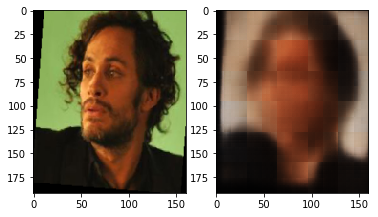

	Epoch 0 batch 3000 loss: 0.011949245817959309
	Epoch 0 batch 4000 loss: 0.00991261750459671


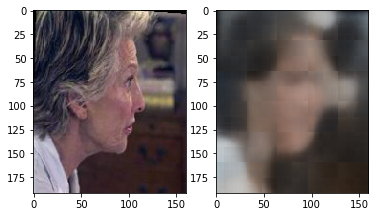

	Epoch 0 batch 5000 loss: 0.009812895208597183
	Epoch 0 batch 6000 loss: 0.008713651448488235


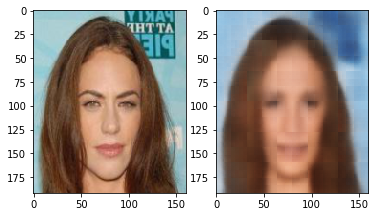

	Epoch 0 batch 7000 loss: 0.007898111827671528
	Epoch 0 batch 8000 loss: 0.008220059797167778


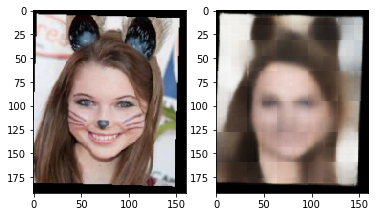

Epoch: 0 Loss: 102.26282336609438


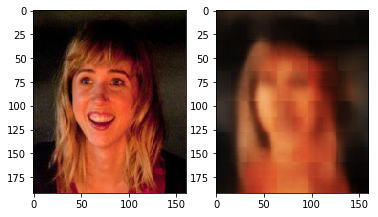

	Epoch 1 batch 1000 loss: 0.007207128219306469
	Epoch 1 batch 2000 loss: 0.007227953057736158


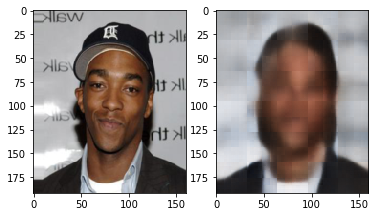

	Epoch 1 batch 3000 loss: 0.006168035790324211
	Epoch 1 batch 4000 loss: 0.006104371976107359


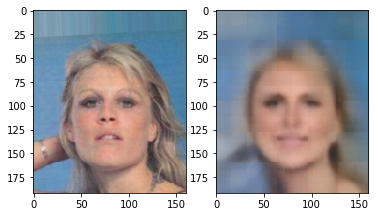

	Epoch 1 batch 5000 loss: 0.005832691211253405
	Epoch 1 batch 6000 loss: 0.005381327588111162


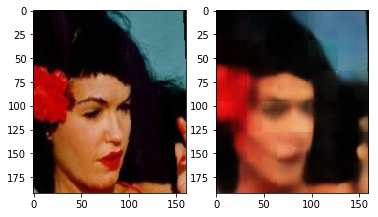

	Epoch 1 batch 7000 loss: 0.005926977377384901
	Epoch 1 batch 8000 loss: 0.00583690544590354


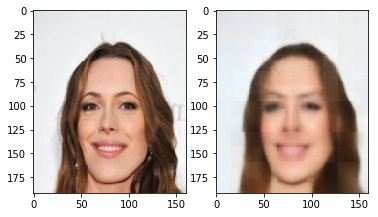

Epoch: 1 Loss: 53.51875047199428


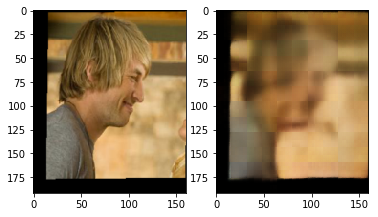

	Epoch 2 batch 1000 loss: 0.005710702855139971
Interrupting... Saving model...
Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

-
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, print_metrics=1000, plot_images=2000, num_epochs=3, display_images=1, scheduler=scheduler, save_path="model_3.pt")

	Epoch 0 batch 1000 loss: 0.005040746182203293
	Epoch 0 batch 2000 loss: 0.005103739444166422
	Epoch 0 batch 3000 loss: 0.004781976342201233


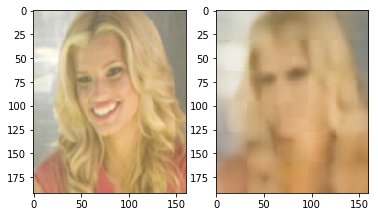

	Epoch 0 batch 4000 loss: 0.005203759763389826
	Epoch 0 batch 5000 loss: 0.0047131790779531
	Epoch 0 batch 6000 loss: 0.00460808165371418


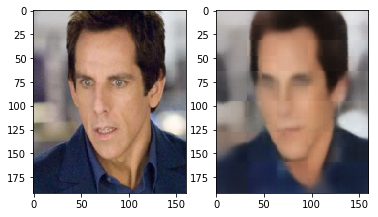

	Epoch 0 batch 7000 loss: 0.004517463501542807
	Epoch 0 batch 8000 loss: 0.0043225414119660854
Epoch: 0 Loss: 40.83976357639767


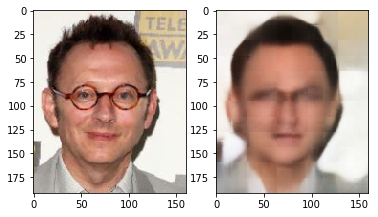

	Epoch 1 batch 1000 loss: 0.0039588878862559795
	Epoch 1 batch 2000 loss: 0.00465892069041729
	Epoch 1 batch 3000 loss: 0.004427705891430378


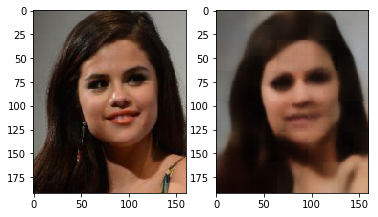

	Epoch 1 batch 4000 loss: 0.004829903598874807
	Epoch 1 batch 5000 loss: 0.004744081292301416
	Epoch 1 batch 6000 loss: 0.004044737666845322


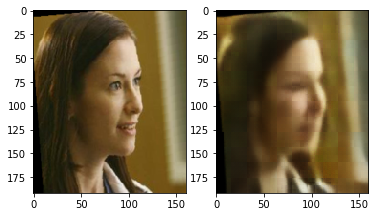

	Epoch 1 batch 7000 loss: 0.004094566218554974
	Epoch 1 batch 8000 loss: 0.004480183124542236
Epoch: 1 Loss: 35.97880330425687


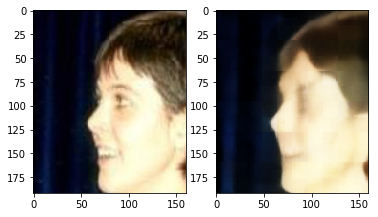

	Epoch 2 batch 1000 loss: 0.0037454101257026196


In [0]:
train(model, train_loader, optimizer, print_metrics=1000, plot_images=3000, num_epochs=3, display_images=1, scheduler=scheduler, save_path="model_3.pt")

	Epoch 1 batch 1000 loss: 0.0034045923966914415
	Epoch 1 batch 2000 loss: 0.003942681010812521
	Epoch 1 batch 3000 loss: 0.003520515514537692


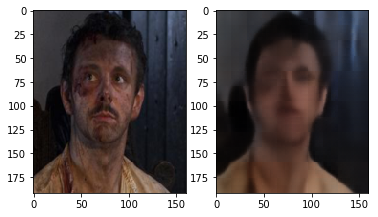

	Epoch 1 batch 4000 loss: 0.0036553237587213516
	Epoch 1 batch 5000 loss: 0.0037778071127831936
	Epoch 1 batch 6000 loss: 0.003713908838108182


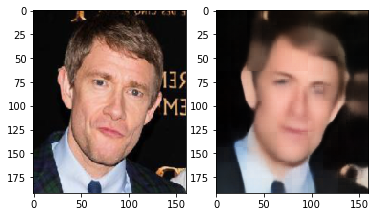

	Epoch 1 batch 7000 loss: 0.003852803958579898
	Epoch 1 batch 8000 loss: 0.003544246545061469
Epoch: 1 Loss: 30.246822604211047


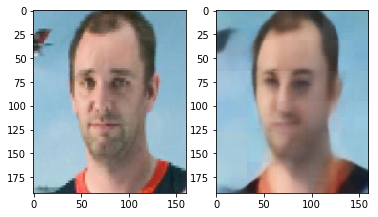

	Epoch 2 batch 1000 loss: 0.0036278804764151573
	Epoch 2 batch 2000 loss: 0.003238068427890539
	Epoch 2 batch 3000 loss: 0.0033669820986688137


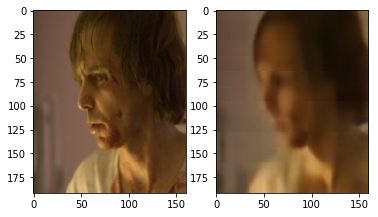

	Epoch 2 batch 4000 loss: 0.003291134024038911
	Epoch 2 batch 5000 loss: 0.003814856056123972
	Epoch 2 batch 6000 loss: 0.0038891611620783806


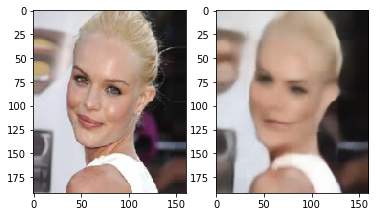

	Epoch 2 batch 7000 loss: 0.0029729059897363186
	Epoch 2 batch 8000 loss: 0.0031989270355552435
Epoch: 2 Loss: 28.650030692806467


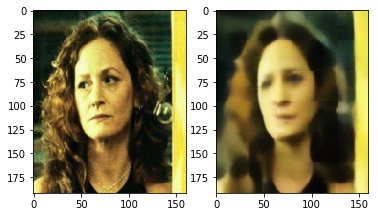

	Epoch 3 batch 1000 loss: 0.0031273062340915203
	Epoch 3 batch 2000 loss: 0.003315916284918785
	Epoch 3 batch 3000 loss: 0.0034951777197420597


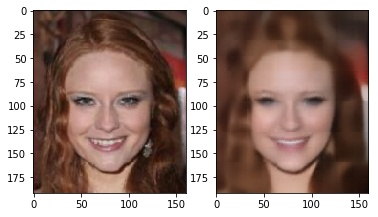

	Epoch 3 batch 4000 loss: 0.003506207372993231
	Epoch 3 batch 5000 loss: 0.003432494355365634
	Epoch 3 batch 6000 loss: 0.00307630212046206


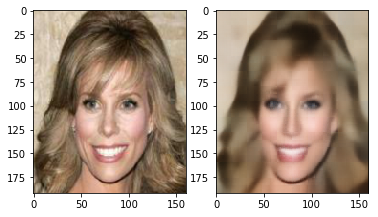

	Epoch 3 batch 7000 loss: 0.0032703743781894445
	Epoch 3 batch 8000 loss: 0.0036606306675821543
Epoch: 3 Loss: 27.376913447631523


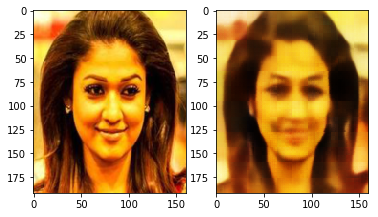

Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

-
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, print_metrics=1000, plot_images=3000, num_epochs=3, display_images=1, scheduler=scheduler, save_path="model_3.pt")

	Epoch 0 batch 1000 loss: 0.003217720426619053
	Epoch 0 batch 2000 loss: 0.003342887619510293
	Epoch 0 batch 3000 loss: 0.0032223740126937628


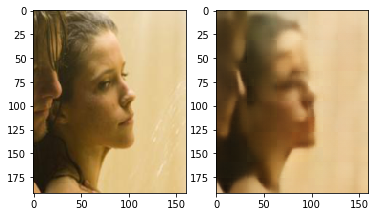

	Epoch 0 batch 4000 loss: 0.00324557744897902
	Epoch 0 batch 5000 loss: 0.003130249911919236
	Epoch 0 batch 6000 loss: 0.0036011086776852608


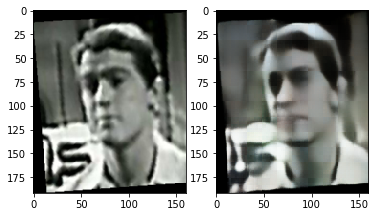

	Epoch 0 batch 7000 loss: 0.002935529686510563
	Epoch 0 batch 8000 loss: 0.0031157215125858784
Epoch: 0 Loss: 26.323966632364318


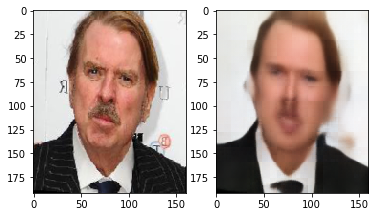

	Epoch 1 batch 1000 loss: 0.0033611059188842773
	Epoch 1 batch 2000 loss: 0.0032675140537321568
	Epoch 1 batch 3000 loss: 0.002858506515622139


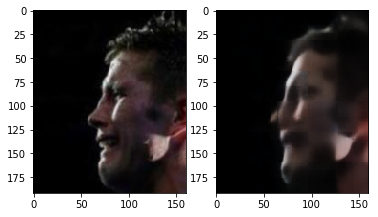

	Epoch 1 batch 4000 loss: 0.0027454043738543987
	Epoch 1 batch 5000 loss: 0.003046807600185275
	Epoch 1 batch 6000 loss: 0.002675481140613556


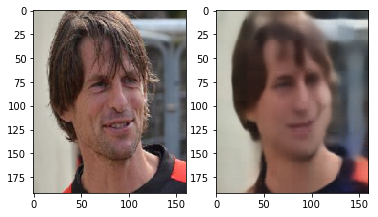

	Epoch 1 batch 7000 loss: 0.002880589570850134
	Epoch 1 batch 8000 loss: 0.0032655477989465
Epoch: 1 Loss: 25.434578981483355


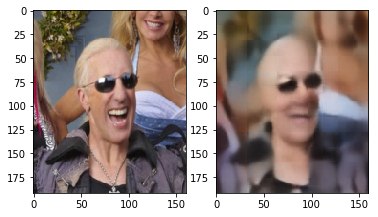

	Epoch 2 batch 1000 loss: 0.0028052758425474167
	Epoch 2 batch 2000 loss: 0.002765357494354248
	Epoch 2 batch 3000 loss: 0.00294707203283906


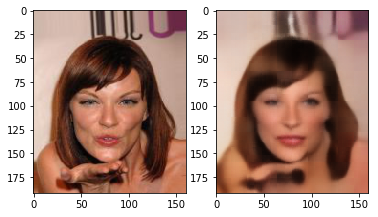

	Epoch 2 batch 4000 loss: 0.003351352410390973
	Epoch 2 batch 5000 loss: 0.0026868083514273167
	Epoch 2 batch 6000 loss: 0.0028079813346266747


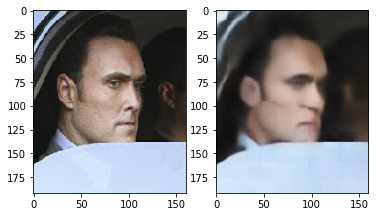

	Epoch 2 batch 7000 loss: 0.002716290531679988
	Epoch 2 batch 8000 loss: 0.003218666184693575
Epoch: 2 Loss: 24.63467610371299


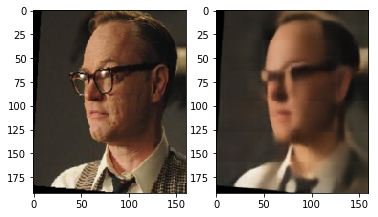

Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

-
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, print_metrics=1000, plot_images=3000, num_epochs=3, display_images=1, scheduler=scheduler, save_path="model_3.pt")

	Epoch 3 batch 1000 loss: 0.0026566791348159313
	Epoch 3 batch 2000 loss: 0.002870570169761777
	Epoch 3 batch 3000 loss: 0.0030622314661741257


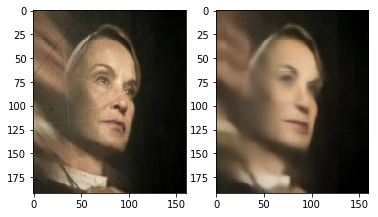

	Epoch 3 batch 4000 loss: 0.0030412538908421993
	Epoch 3 batch 5000 loss: 0.0029362025670707226
	Epoch 3 batch 6000 loss: 0.0028824538458138704


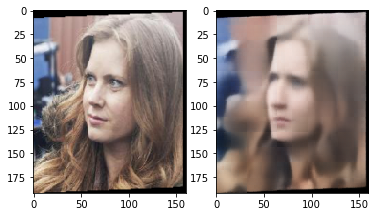

	Epoch 3 batch 7000 loss: 0.003468472044914961
	Epoch 3 batch 8000 loss: 0.0028447865042835474
Epoch: 3 Loss: 23.95191014953889


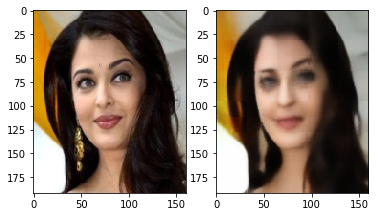

	Epoch 4 batch 1000 loss: 0.002594531513750553
	Epoch 4 batch 2000 loss: 0.0028645070269703865
	Epoch 4 batch 3000 loss: 0.002499994821846485


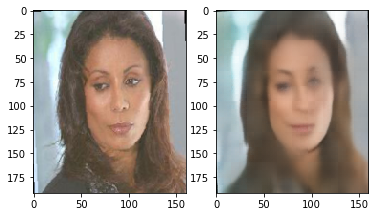

	Epoch 4 batch 4000 loss: 0.002725545084103942
	Epoch 4 batch 5000 loss: 0.0026067011058330536
	Epoch 4 batch 6000 loss: 0.002701124409213662


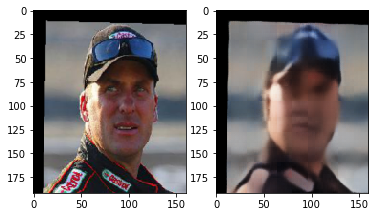

	Epoch 4 batch 7000 loss: 0.0030260870698839426
	Epoch 4 batch 8000 loss: 0.0028433797415345907
Epoch: 4 Loss: 23.35735035385005


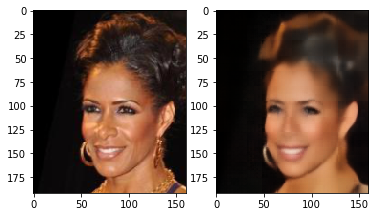

	Epoch 5 batch 1000 loss: 0.002844729460775852
	Epoch 5 batch 2000 loss: 0.0032275901176035404
	Epoch 5 batch 3000 loss: 0.0026266276836395264


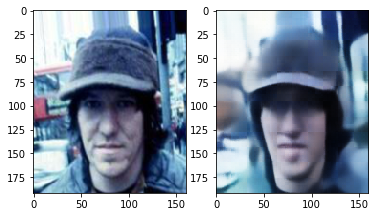

	Epoch 5 batch 4000 loss: 0.002736507449299097
	Epoch 5 batch 5000 loss: 0.002863267669454217
	Epoch 5 batch 6000 loss: 0.002851120661944151


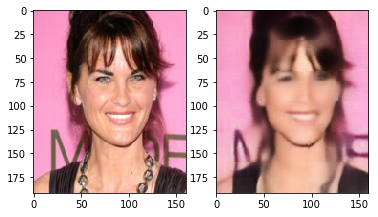

	Epoch 5 batch 7000 loss: 0.0025937138125300407
	Epoch 5 batch 8000 loss: 0.0031651854515075684
Epoch: 5 Loss: 22.794727332657203


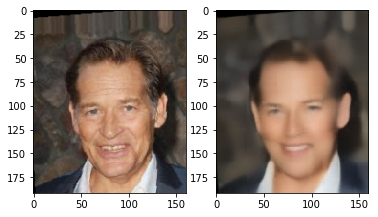

Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

-
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, print_metrics=1000, plot_images=3000, num_epochs=3, display_images=1, scheduler=scheduler, save_path="model_3.pt")

	Epoch 0 batch 1000 loss: 0.0025456983130425215
	Epoch 0 batch 2000 loss: 0.00274693057872355
	Epoch 0 batch 3000 loss: 0.0022773724049329758
	Epoch 0 batch 4000 loss: 0.002952312119305134


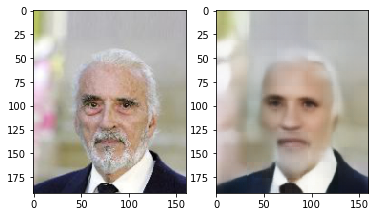

	Epoch 0 batch 5000 loss: 0.002437689108774066
	Epoch 0 batch 6000 loss: 0.0031423692125827074
	Epoch 0 batch 7000 loss: 0.0025272308848798275
	Epoch 0 batch 8000 loss: 0.0028089198749512434


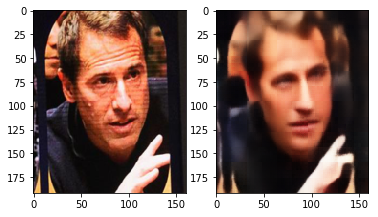

Epoch: 0 Loss: 22.30609048786573


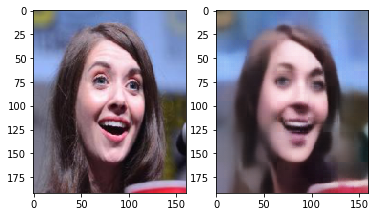

	Epoch 1 batch 1000 loss: 0.0029020006768405437
	Epoch 1 batch 2000 loss: 0.002283034846186638
	Epoch 1 batch 3000 loss: 0.0027682194486260414
	Epoch 1 batch 4000 loss: 0.002629930153489113


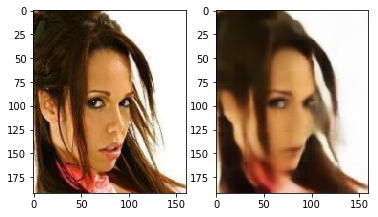

	Epoch 1 batch 5000 loss: 0.0028337801340967417
	Epoch 1 batch 6000 loss: 0.002769258338958025
	Epoch 1 batch 7000 loss: 0.0026196984108537436
	Epoch 1 batch 8000 loss: 0.002594619756564498


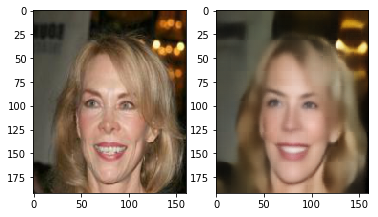

Epoch: 1 Loss: 21.88056584284641


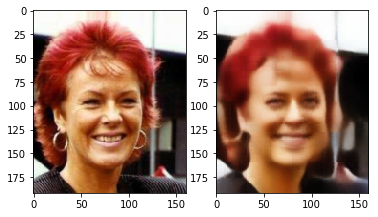

	Epoch 2 batch 1000 loss: 0.0025940972846001387
	Epoch 2 batch 2000 loss: 0.002415998373180628
	Epoch 2 batch 3000 loss: 0.0029615135863423347
	Epoch 2 batch 4000 loss: 0.0029296288266777992


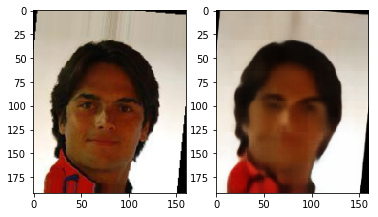

	Epoch 2 batch 5000 loss: 0.0027639835607260466
	Epoch 2 batch 6000 loss: 0.0027089109644293785
	Epoch 2 batch 7000 loss: 0.0023578645195811987
	Epoch 2 batch 8000 loss: 0.0027655712328851223


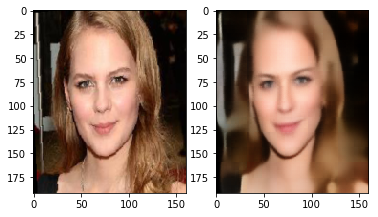

Epoch: 2 Loss: 21.471527485875413


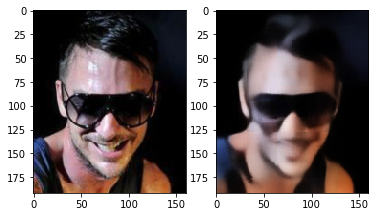

Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

-
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, print_metrics=1000, plot_images=4000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 3 batch 1000 loss: 0.0027971502859145403
	Epoch 3 batch 2000 loss: 0.0024403943680226803
	Epoch 3 batch 3000 loss: 0.0027574391569942236
	Epoch 3 batch 4000 loss: 0.002438622061163187


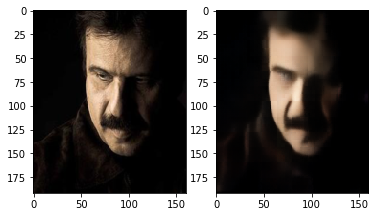

	Epoch 3 batch 5000 loss: 0.002817727392539382
	Epoch 3 batch 6000 loss: 0.0026555433869361877
	Epoch 3 batch 7000 loss: 0.0026010507717728615
	Epoch 3 batch 8000 loss: 0.0024174461141228676


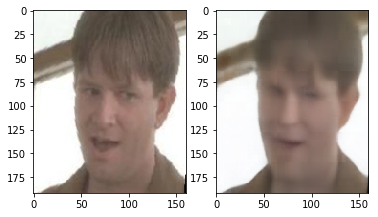

Epoch: 3 Loss: 21.097744894679636


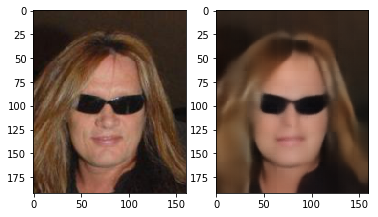

	Epoch 4 batch 1000 loss: 0.002284453948959708
	Epoch 4 batch 2000 loss: 0.002669314155355096
	Epoch 4 batch 3000 loss: 0.0021279933862388134
	Epoch 4 batch 4000 loss: 0.0022727588657289743


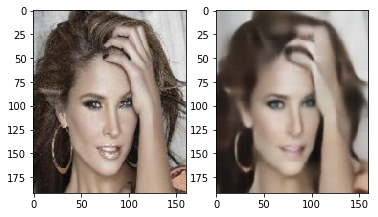

	Epoch 4 batch 5000 loss: 0.002491090912371874
	Epoch 4 batch 6000 loss: 0.002860224572941661
	Epoch 4 batch 7000 loss: 0.0024105363991111517
	Epoch 4 batch 8000 loss: 0.0025502736680209637


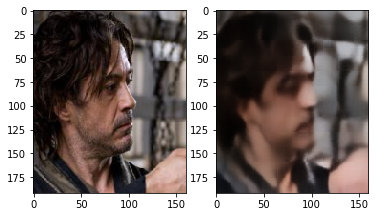

Epoch: 4 Loss: 20.76650922326371


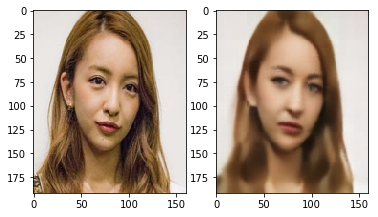

	Epoch 5 batch 1000 loss: 0.0026103518903255463
	Epoch 5 batch 2000 loss: 0.002709329826757312
	Epoch 5 batch 3000 loss: 0.002229047706350684
	Epoch 5 batch 4000 loss: 0.002428350504487753


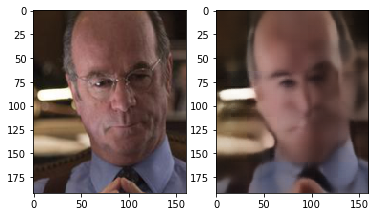

	Epoch 5 batch 5000 loss: 0.0030671819113194942
	Epoch 5 batch 6000 loss: 0.0023879357613623142
	Epoch 5 batch 7000 loss: 0.002202784875407815
	Epoch 5 batch 8000 loss: 0.002724746009334922


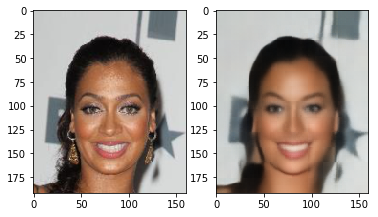

Epoch: 5 Loss: 20.415023239911534


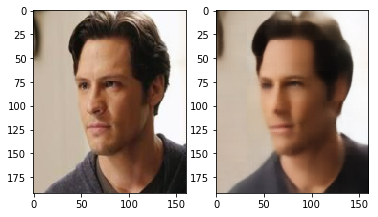

Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

\
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, print_metrics=1000, plot_images=4000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 1 batch 1000 loss: 0.0026227731723338366
	Epoch 1 batch 2000 loss: 0.00203268276527524
	Epoch 1 batch 3000 loss: 0.0025285384617745876
	Epoch 1 batch 4000 loss: 0.002301324624568224
	Epoch 1 batch 5000 loss: 0.002549262484535575


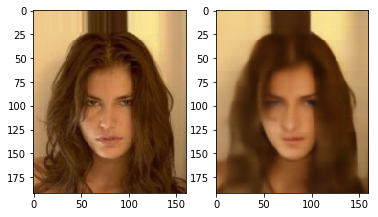

	Epoch 1 batch 6000 loss: 0.002089085755869746
	Epoch 1 batch 7000 loss: 0.0021229407284408808
	Epoch 1 batch 8000 loss: 0.002530180150642991
Epoch: 1 Loss: 20.114710005698726


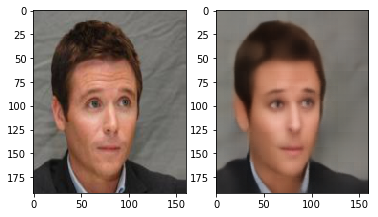

	Epoch 2 batch 1000 loss: 0.0022407372016459703
	Epoch 2 batch 2000 loss: 0.002962652361020446
	Epoch 2 batch 3000 loss: 0.0022803721949458122
	Epoch 2 batch 4000 loss: 0.0022517116740345955
	Epoch 2 batch 5000 loss: 0.002419775817543268


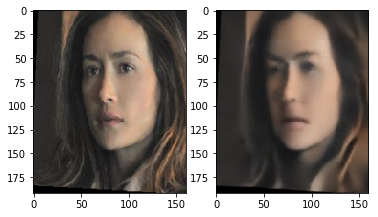

	Epoch 2 batch 6000 loss: 0.002330325311049819
	Epoch 2 batch 7000 loss: 0.0022884232457727194
	Epoch 2 batch 8000 loss: 0.00237356498837471
Epoch: 2 Loss: 19.85521802410949


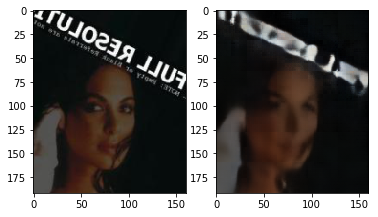

	Epoch 3 batch 1000 loss: 0.002396749099716544
	Epoch 3 batch 2000 loss: 0.0025407648645341396
	Epoch 3 batch 3000 loss: 0.002414695918560028
	Epoch 3 batch 4000 loss: 0.002122202655300498
	Epoch 3 batch 5000 loss: 0.002401423640549183


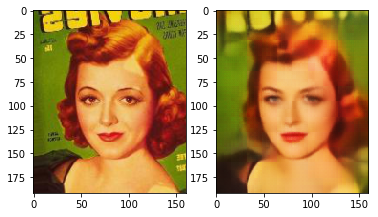

	Epoch 3 batch 6000 loss: 0.0021681501530110836
	Epoch 3 batch 7000 loss: 0.002513352083042264
	Epoch 3 batch 8000 loss: 0.00256067025475204
Epoch: 3 Loss: 19.58310901420191


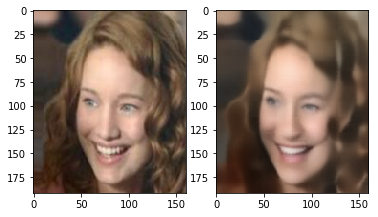

Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

-
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, print_metrics=1000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 4 batch 1000 loss: 0.002463867887854576
	Epoch 4 batch 2000 loss: 0.0025016090366989374
	Epoch 4 batch 3000 loss: 0.0023094555363059044
	Epoch 4 batch 4000 loss: 0.002333980053663254
	Epoch 4 batch 5000 loss: 0.0022559952922165394


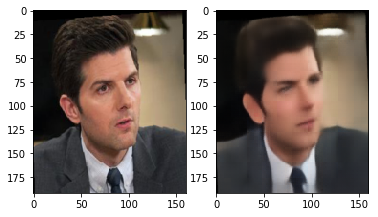

	Epoch 4 batch 6000 loss: 0.0020467073190957308
	Epoch 4 batch 7000 loss: 0.0020478691440075636
	Epoch 4 batch 8000 loss: 0.0020754672586917877
Epoch: 4 Loss: 19.334579902351834


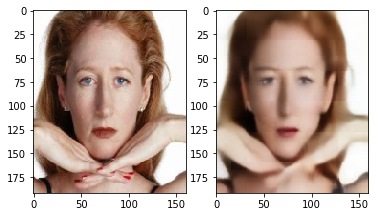

	Epoch 5 batch 1000 loss: 0.0021302164532244205
	Epoch 5 batch 2000 loss: 0.0020619798451662064
	Epoch 5 batch 3000 loss: 0.002230983227491379
	Epoch 5 batch 4000 loss: 0.001976377796381712
	Epoch 5 batch 5000 loss: 0.002378456760197878


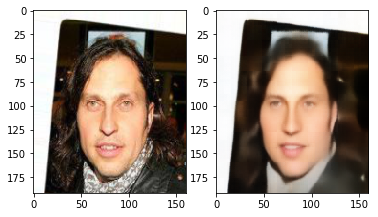

	Epoch 5 batch 6000 loss: 0.002299204468727112
	Epoch 5 batch 7000 loss: 0.0022020996548235416
	Epoch 5 batch 8000 loss: 0.002258913591504097
Epoch: 5 Loss: 19.105376576422714


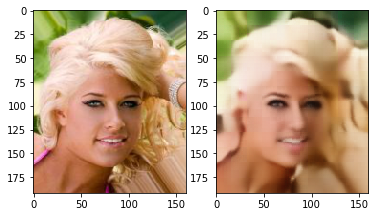

	Epoch 6 batch 1000 loss: 0.0022132613230496645
	Epoch 6 batch 2000 loss: 0.002435314003378153
	Epoch 6 batch 3000 loss: 0.0022517377510666847
	Epoch 6 batch 4000 loss: 0.0021744819823652506
	Epoch 6 batch 5000 loss: 0.002331638243049383


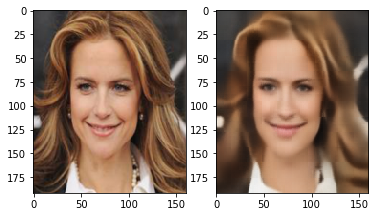

	Epoch 6 batch 6000 loss: 0.0023538146633654833
	Epoch 6 batch 7000 loss: 0.002101119374856353
	Epoch 6 batch 8000 loss: 0.002248835051432252
Epoch: 6 Loss: 18.90103450859897


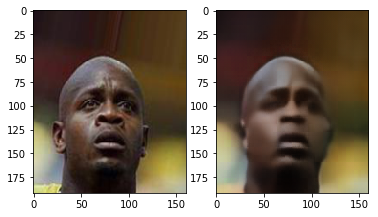

Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

\
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, print_metrics=1000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 3 batch 1000 loss: 0.0020818819757550955
	Epoch 3 batch 2000 loss: 0.0018815526273101568
	Epoch 3 batch 3000 loss: 0.0021110319066792727
	Epoch 3 batch 4000 loss: 0.0022380345035344362
	Epoch 3 batch 5000 loss: 0.0023685635533183813


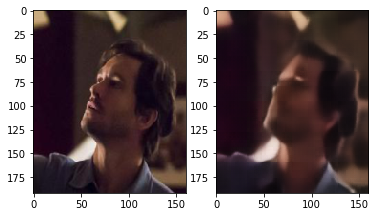

	Epoch 3 batch 6000 loss: 0.002463230397552252
	Epoch 3 batch 7000 loss: 0.0024869879707694054
	Epoch 3 batch 8000 loss: 0.0019006052752956748
Epoch: 3 Loss: 18.24858244252391


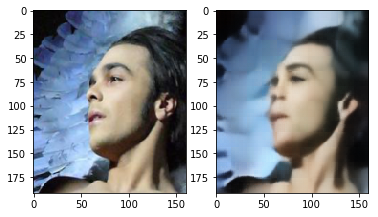

	Epoch 4 batch 1000 loss: 0.0025247528683394194
	Epoch 4 batch 2000 loss: 0.0019228463061153889
	Epoch 4 batch 3000 loss: 0.001974766841158271
	Epoch 4 batch 4000 loss: 0.0024399240501224995
	Epoch 4 batch 5000 loss: 0.0022080116905272007


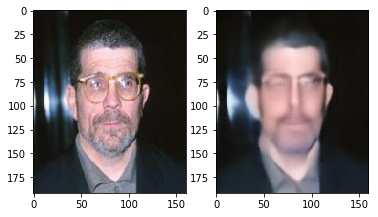

	Epoch 4 batch 6000 loss: 0.0020352669525891542
	Epoch 4 batch 7000 loss: 0.002370141912251711
	Epoch 4 batch 8000 loss: 0.0023095523938536644
Epoch: 4 Loss: 18.080135766416788


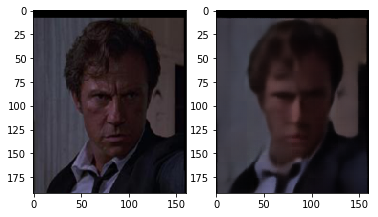

	Epoch 5 batch 1000 loss: 0.0023951788898557425
	Epoch 5 batch 2000 loss: 0.0021806182339787483
	Epoch 5 batch 3000 loss: 0.0021524587646126747
	Epoch 5 batch 4000 loss: 0.0022648326121270657
	Epoch 5 batch 5000 loss: 0.0019623292610049248


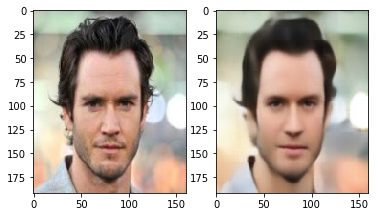

	Epoch 5 batch 6000 loss: 0.002115835202857852
	Epoch 5 batch 7000 loss: 0.0020701151806861162
	Epoch 5 batch 8000 loss: 0.002192015526816249
Epoch: 5 Loss: 17.941115825786255


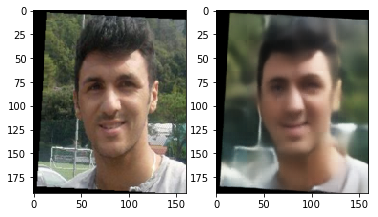

Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

|
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, print_metrics=1000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 1 batch 2000 loss: 0.0019504533847793937
	Epoch 1 batch 4000 loss: 0.0022284553851932287


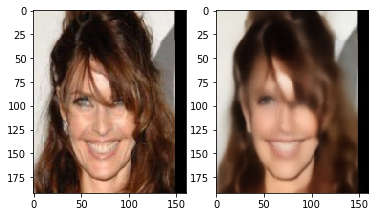

	Epoch 1 batch 6000 loss: 0.0022894791327416897
	Epoch 1 batch 8000 loss: 0.001953441184014082
Epoch: 1 Loss: 17.197952054208145


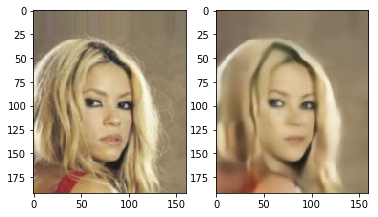

	Epoch 2 batch 2000 loss: 0.001986458897590637
	Epoch 2 batch 4000 loss: 0.001862474251538515


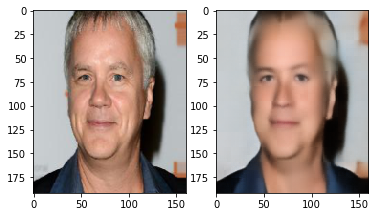

	Epoch 2 batch 6000 loss: 0.002066728426143527
	Epoch 2 batch 8000 loss: 0.0021934721153229475
Epoch: 2 Loss: 17.070960968034342


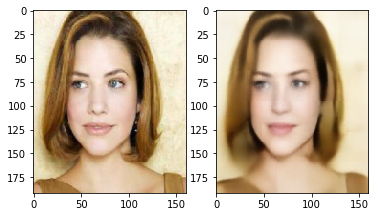

	Epoch 3 batch 2000 loss: 0.0021186016965657473
	Epoch 3 batch 4000 loss: 0.0024127145297825336


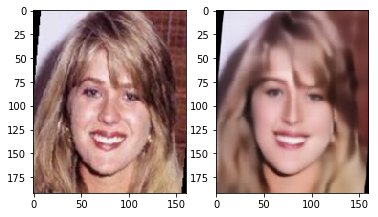

	Epoch 3 batch 6000 loss: 0.001975973369553685
	Epoch 3 batch 8000 loss: 0.0021695198956876993
Epoch: 3 Loss: 16.94561641709879


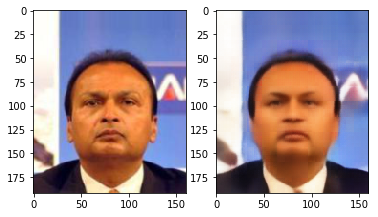

Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

\
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 4 batch 2000 loss: 0.0019598875660449266
	Epoch 4 batch 4000 loss: 0.0018956647254526615


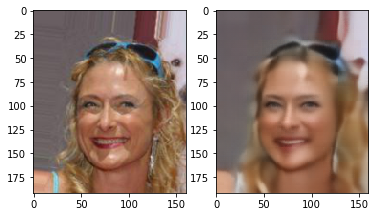

	Epoch 4 batch 6000 loss: 0.0024447885807603598
	Epoch 4 batch 8000 loss: 0.0021123189944773912


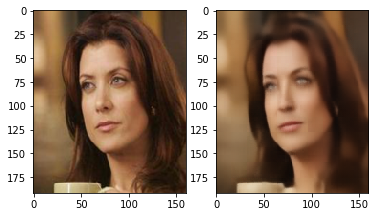

Epoch: 4 Loss: 16.840535604511388


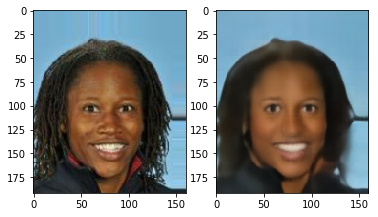

	Epoch 5 batch 2000 loss: 0.001991365570574999
	Epoch 5 batch 4000 loss: 0.001996803330257535


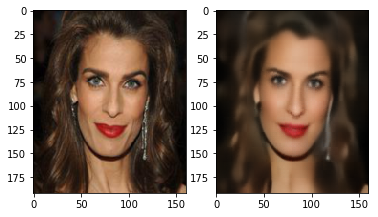

	Epoch 5 batch 6000 loss: 0.0024579386226832867
	Epoch 5 batch 8000 loss: 0.0019062368664890528


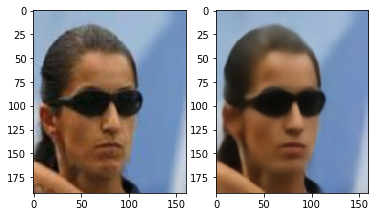

Epoch: 5 Loss: 16.726120842504315


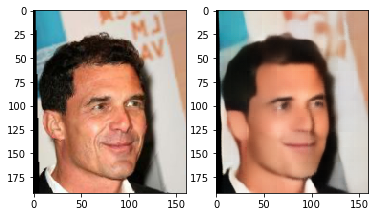

	Epoch 6 batch 2000 loss: 0.002155134454369545
	Epoch 6 batch 4000 loss: 0.0017816154286265373


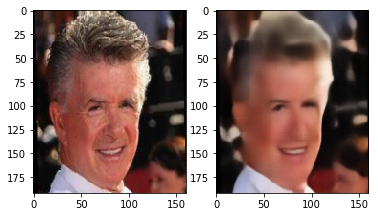

	Epoch 6 batch 6000 loss: 0.001856369897723198
	Epoch 6 batch 8000 loss: 0.0020192316733300686


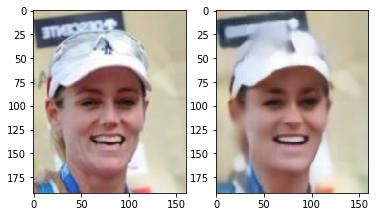

Epoch: 6 Loss: 16.623896769597195


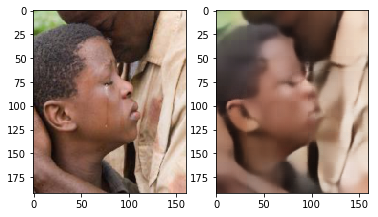

Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

\
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, print_metrics=2000, plot_images=4000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 0 batch 2000 loss: 0.001970840385183692
	Epoch 0 batch 4000 loss: 0.0020220286678522825


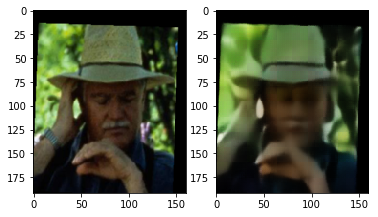

	Epoch 0 batch 6000 loss: 0.0017945432337000966
	Epoch 0 batch 8000 loss: 0.0018728269496932626


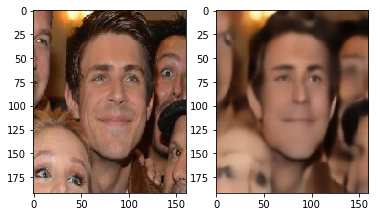

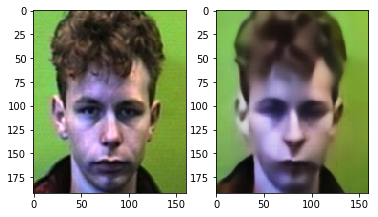

Epoch: 0 Train Loss: 16.17390894377604 Test Loss: 0.4582886900752783
	Epoch 1 batch 2000 loss: 0.002025293419137597
	Epoch 1 batch 4000 loss: 0.001862513949163258


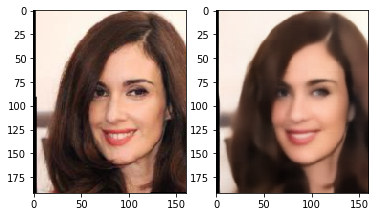

	Epoch 1 batch 6000 loss: 0.002012268640100956
	Epoch 1 batch 8000 loss: 0.001851978711783886


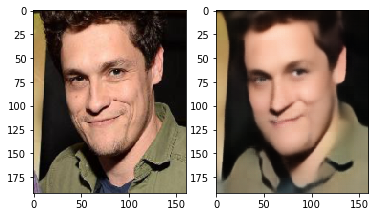

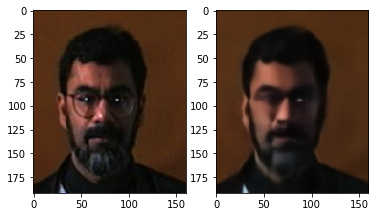

Epoch: 1 Train Loss: 16.092596121830866 Test Loss: 0.4606778178131208
Interrupting... Saving model...
Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

-
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, test_loader=test_loader, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 0 batch 2000 loss: 0.0017844542162492871
	Epoch 0 batch 4000 loss: 0.001855854643508792


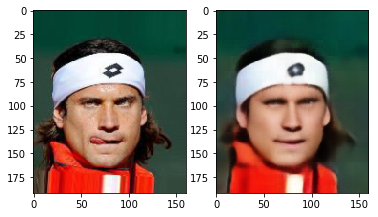

	Epoch 0 batch 6000 loss: 0.0017893562326207757
	Epoch 0 batch 8000 loss: 0.001651229802519083


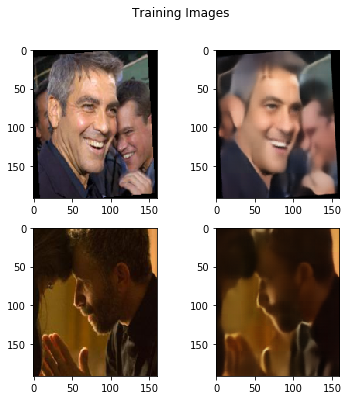

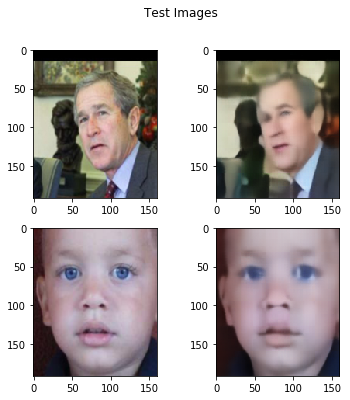

Epoch: 0 Train Loss: 16.005676362430677 Test Loss: 0.7384858381119557
	Epoch 1 batch 2000 loss: 0.0017917195800691843
	Epoch 1 batch 4000 loss: 0.0018847915343940258


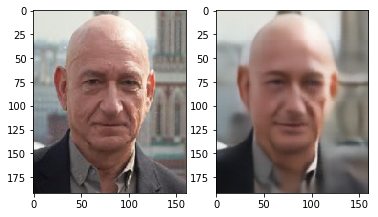

	Epoch 1 batch 6000 loss: 0.0018526505446061492
	Epoch 1 batch 8000 loss: 0.0018734735203906894


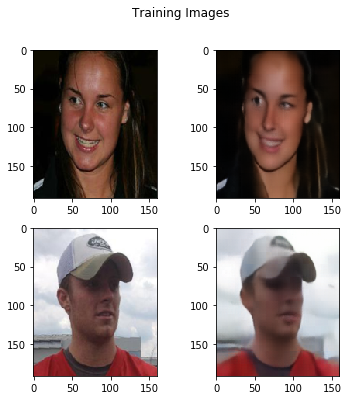

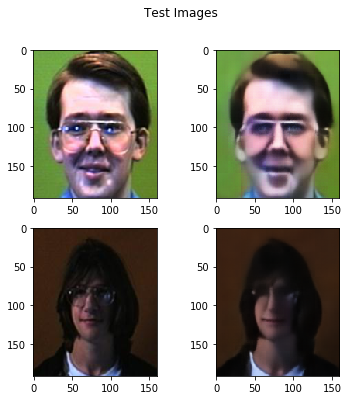

Epoch: 1 Train Loss: 15.952285461942665 Test Loss: 0.738689735182561
	Epoch 2 batch 2000 loss: 0.0020537141244858503
	Epoch 2 batch 4000 loss: 0.0016658487729728222


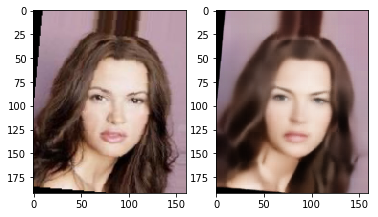

	Epoch 2 batch 6000 loss: 0.0017758298199623823
	Epoch 2 batch 8000 loss: 0.0019987758714705706


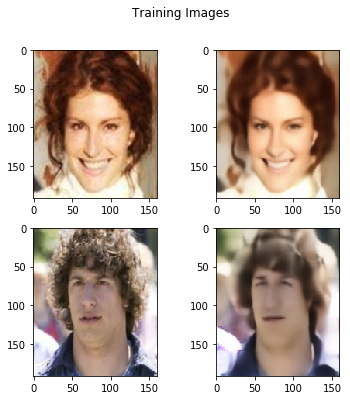

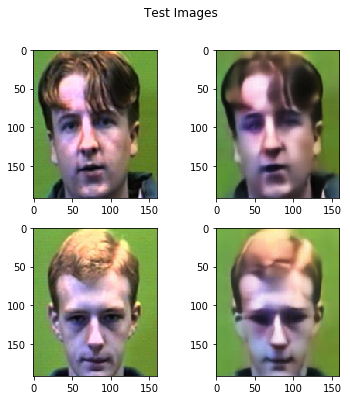

Epoch: 2 Train Loss: 15.872420059749857 Test Loss: 0.7378285855520517
Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

\
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, test_loader=test_loader, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 3 batch 2000 loss: 0.001791250193491578
	Epoch 3 batch 4000 loss: 0.0016767974011600018


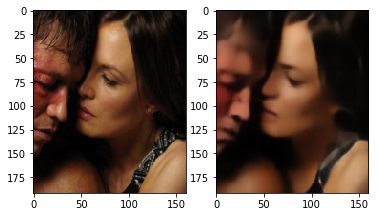

	Epoch 3 batch 6000 loss: 0.0017889548325911164
	Epoch 3 batch 8000 loss: 0.0017834305763244629


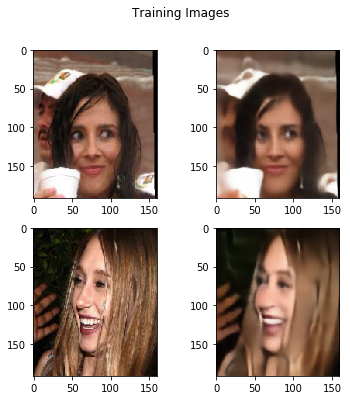

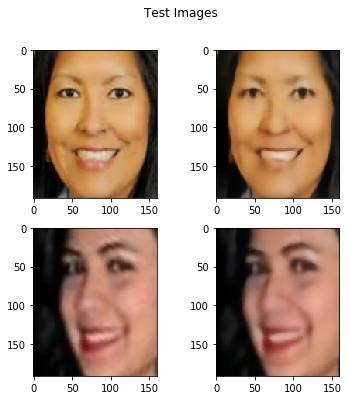

Epoch: 3 Train Loss: 15.808786588953808 Test Loss: 0.7283253242494538
	Epoch 4 batch 2000 loss: 0.0017936370568349957
	Epoch 4 batch 4000 loss: 0.0019298804691061378


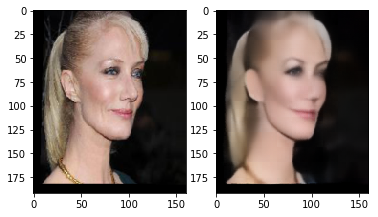

	Epoch 4 batch 6000 loss: 0.0018769886810332537
	Epoch 4 batch 8000 loss: 0.0019021391635760665


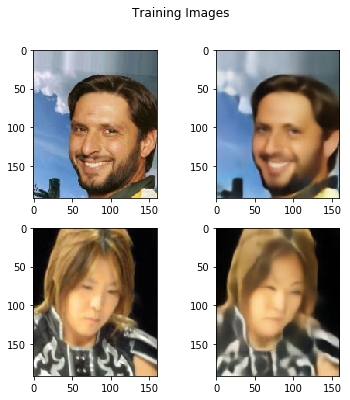

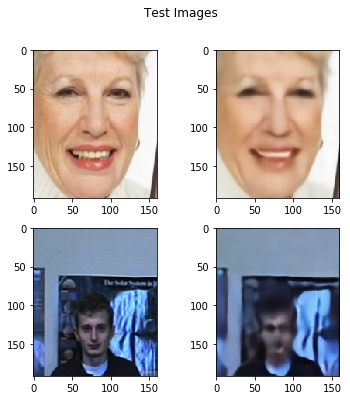

Epoch: 4 Train Loss: 15.73607468244154 Test Loss: 0.7136909709661268
	Epoch 5 batch 2000 loss: 0.0017061639809980989
	Epoch 5 batch 4000 loss: 0.001987375319004059


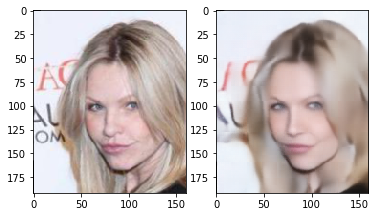

	Epoch 5 batch 6000 loss: 0.0016873680287972093
	Epoch 5 batch 8000 loss: 0.0018340209499001503


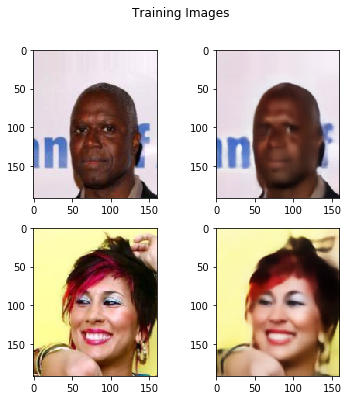

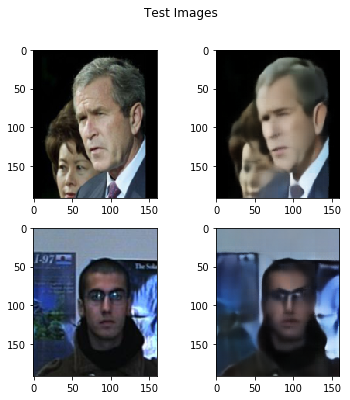

Epoch: 5 Train Loss: 15.674723528092727 Test Loss: 0.7153712586150505
Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

/
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, test_loader=test_loader, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 1 batch 2000 loss: 0.0016239120159298182
	Epoch 1 batch 4000 loss: 0.0019296393729746342


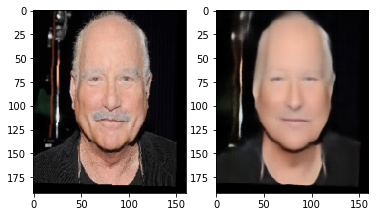

	Epoch 1 batch 6000 loss: 0.0020041835960000753
	Epoch 1 batch 8000 loss: 0.0018819106044247746


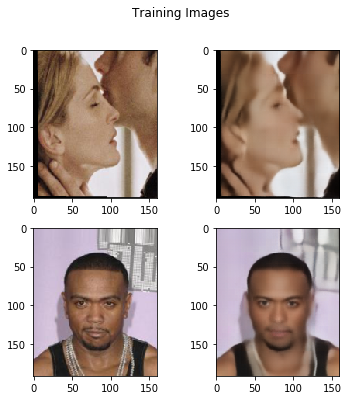

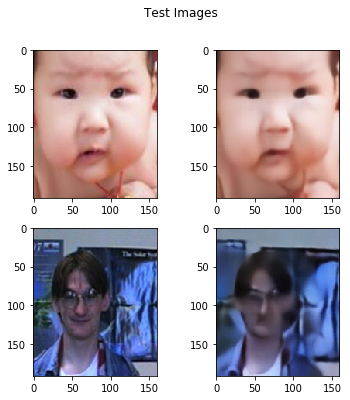

Epoch: 1 Train Loss: 15.464851797325537 Test Loss: 0.7014638799591921
	Epoch 2 batch 2000 loss: 0.0018794015049934387
	Epoch 2 batch 4000 loss: 0.0019546994008123875


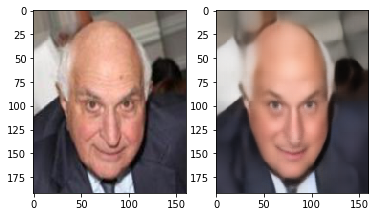

	Epoch 2 batch 6000 loss: 0.0019569804426282644
	Epoch 2 batch 8000 loss: 0.0018960582092404366


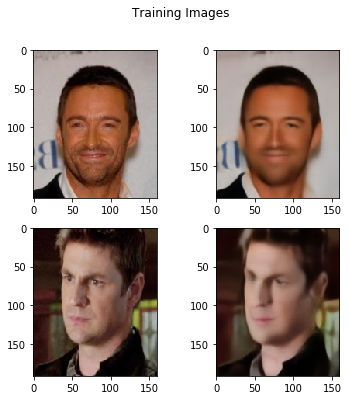

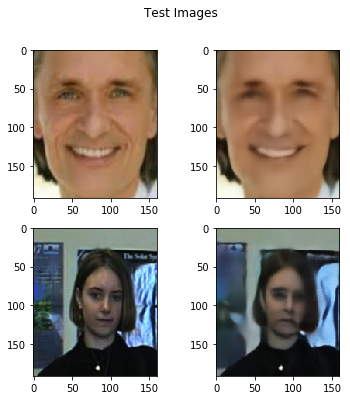

Epoch: 2 Train Loss: 15.41129768115934 Test Loss: 0.6967210008879192
	Epoch 3 batch 2000 loss: 0.0019029586110264063
	Epoch 3 batch 4000 loss: 0.001691036974079907


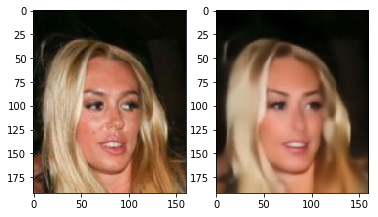

	Epoch 3 batch 6000 loss: 0.001959769520908594
	Epoch 3 batch 8000 loss: 0.0017144721932709217


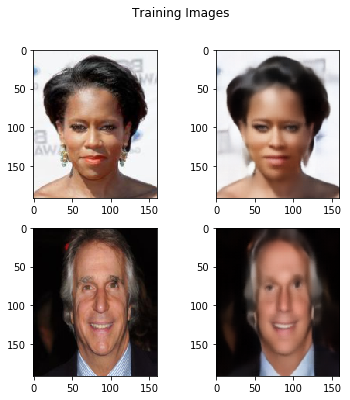

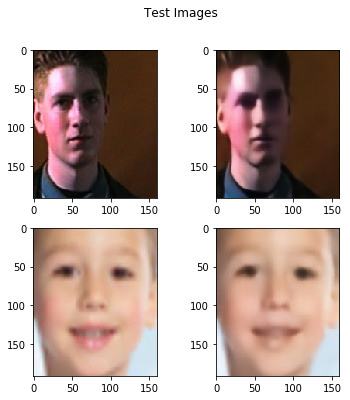

Epoch: 3 Train Loss: 15.361409150646068 Test Loss: 0.6986343550379388
Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

/
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, test_loader=test_loader, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 29 batch 2000 loss: 0.0019338978454470634
	Epoch 29 batch 4000 loss: 0.0018780108075588942


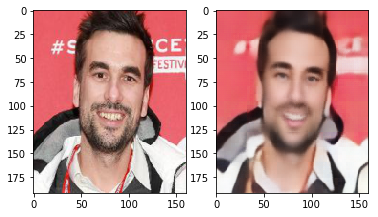

	Epoch 29 batch 6000 loss: 0.002247092081233859
	Epoch 29 batch 8000 loss: 0.0017199988942593336


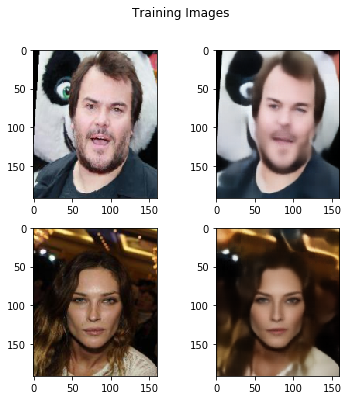

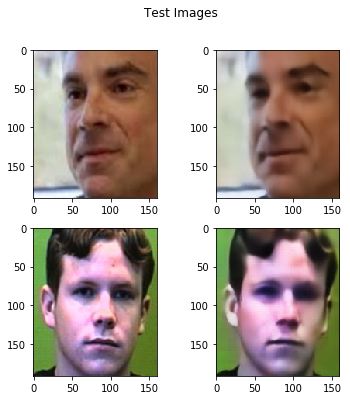

Epoch: 29 Train Loss: 15.255413618637249 Test Loss: 0.6905985822668299
	Epoch 30 batch 2000 loss: 0.001581093529239297
	Epoch 30 batch 4000 loss: 0.0018877077382057905


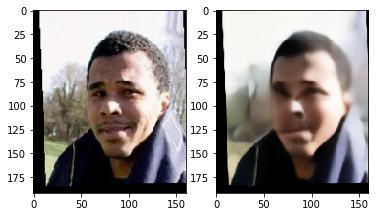

	Epoch 30 batch 6000 loss: 0.001736170263029635
	Epoch 30 batch 8000 loss: 0.00211516791023314


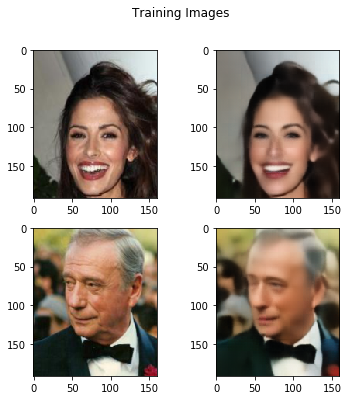

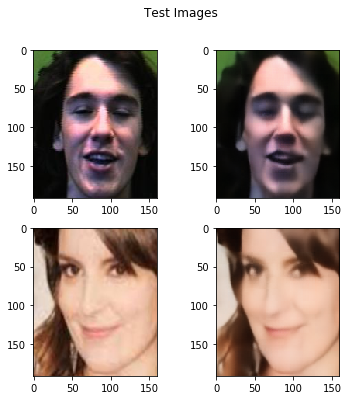

Epoch: 30 Train Loss: 15.200382223934866 Test Loss: 0.6948226479580626
	Epoch 31 batch 2000 loss: 0.0018510300433263183
	Epoch 31 batch 4000 loss: 0.001921951537951827


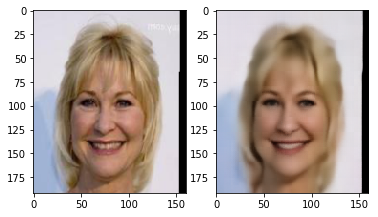

	Epoch 31 batch 6000 loss: 0.0015520781744271517
	Epoch 31 batch 8000 loss: 0.0017818489577621222


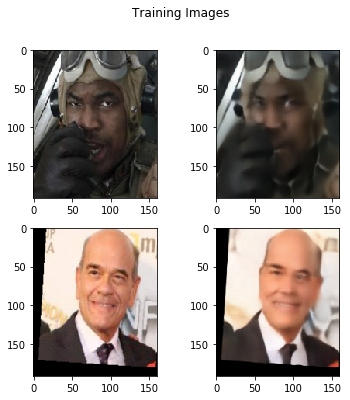

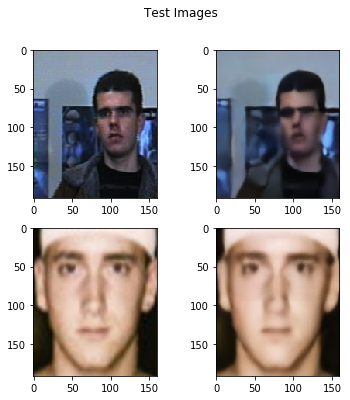

Epoch: 31 Train Loss: 15.149148336378857 Test Loss: 0.6851639078813605
Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

-
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, test_loader=test_loader, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 0 batch 2000 loss: 0.0020683039911091328
	Epoch 0 batch 4000 loss: 0.0017174589447677135


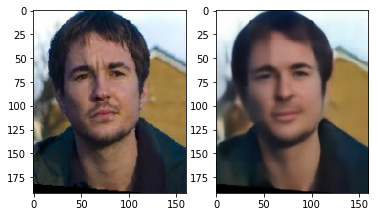

	Epoch 0 batch 6000 loss: 0.001756229903548956
	Epoch 0 batch 8000 loss: 0.001787153771147132


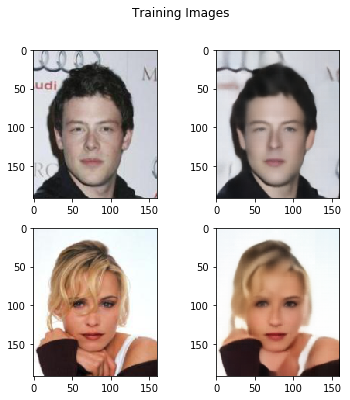

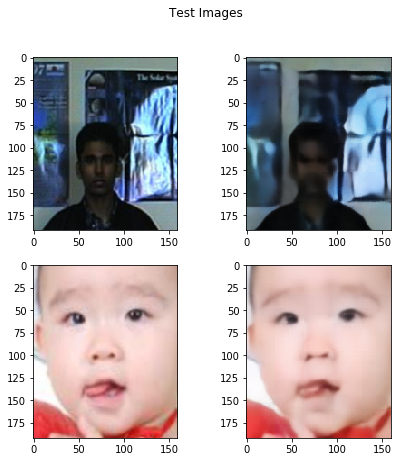

Epoch: 0 Train Loss: 15.078296244028024 Test Loss: 0.6801121712778695
	Epoch 1 batch 2000 loss: 0.0016514878952875733
	Epoch 1 batch 4000 loss: 0.0018510225927457213


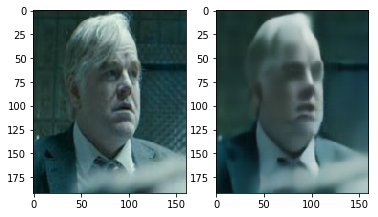

	Epoch 1 batch 6000 loss: 0.0017095457296818495
	Epoch 1 batch 8000 loss: 0.0017858598148450255


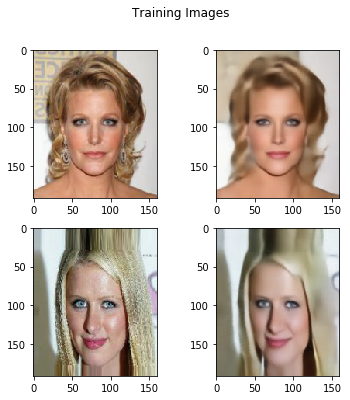

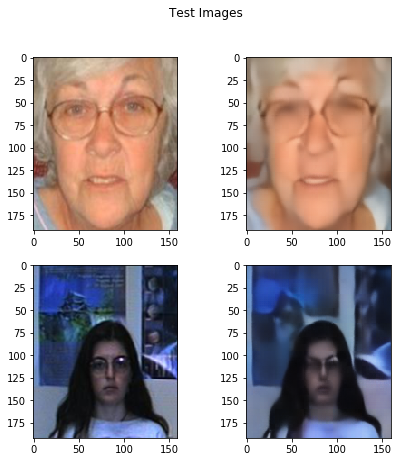

Epoch: 1 Train Loss: 15.043862503371201 Test Loss: 0.683057973801624
	Epoch 2 batch 2000 loss: 0.0016539640491828322
	Epoch 2 batch 4000 loss: 0.0016200668178498745


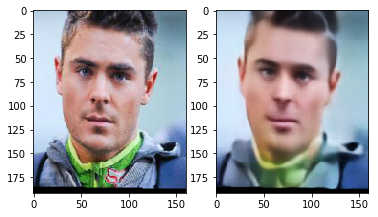

	Epoch 2 batch 6000 loss: 0.001642789808101952
	Epoch 2 batch 8000 loss: 0.0019005837384611368


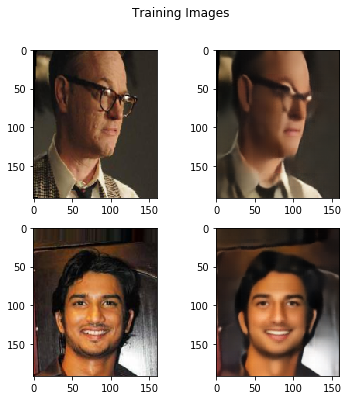

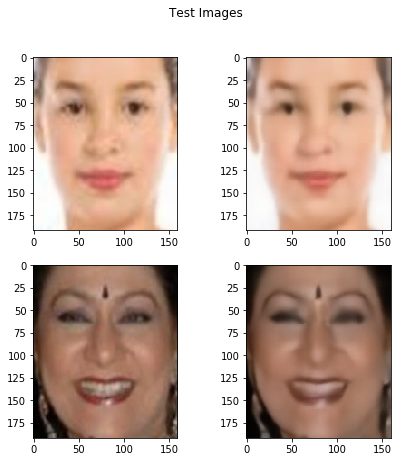

Epoch: 2 Train Loss: 15.00052686885465 Test Loss: 0.678969043015968
Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

/
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, test_loader=test_loader, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 3 batch 2000 loss: 0.0018818294629454613
	Epoch 3 batch 4000 loss: 0.0015367553569376469


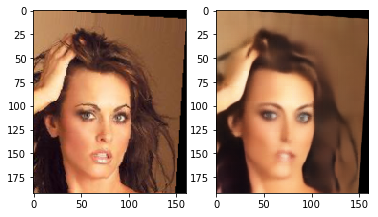

	Epoch 3 batch 6000 loss: 0.0016063757939264178
	Epoch 3 batch 8000 loss: 0.00201403652317822


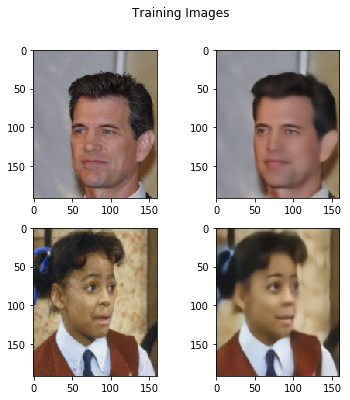

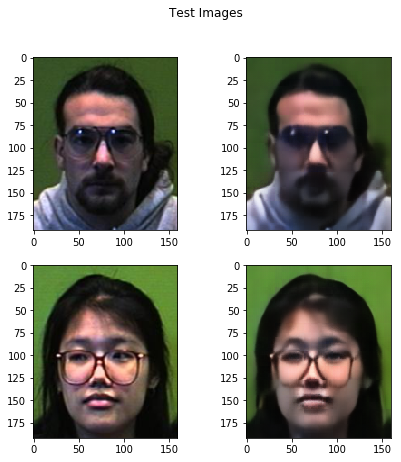

Epoch: 3 Train Loss: 14.954360471223481 Test Loss: 0.6724228400853463
	Epoch 4 batch 2000 loss: 0.0018312999745830894
	Epoch 4 batch 4000 loss: 0.0016660160617902875


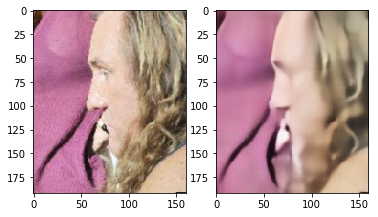

	Epoch 4 batch 6000 loss: 0.0019890337716788054
	Epoch 4 batch 8000 loss: 0.0016887430101633072


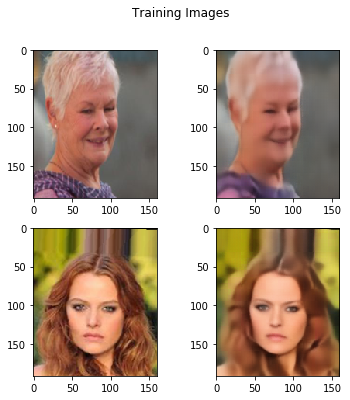

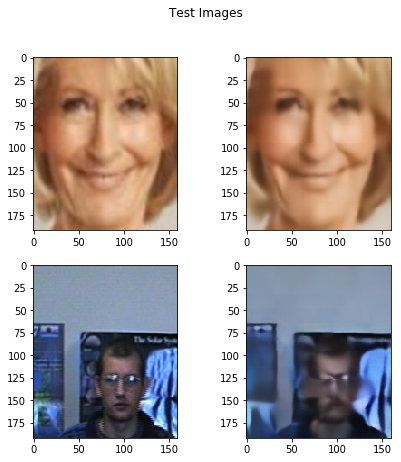

Epoch: 4 Train Loss: 14.917447405983694 Test Loss: 0.6746865406166762
	Epoch 5 batch 2000 loss: 0.00200198357924819
	Epoch 5 batch 4000 loss: 0.001675408217124641


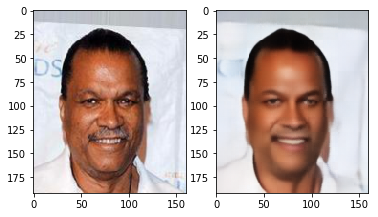

	Epoch 5 batch 6000 loss: 0.0019265704322606325
	Epoch 5 batch 8000 loss: 0.0020985554438084364


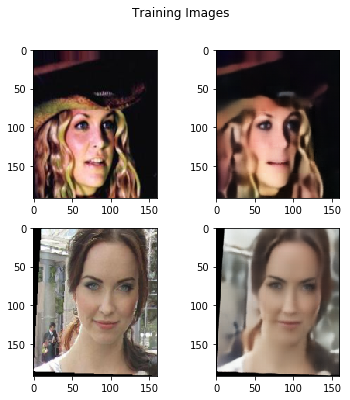

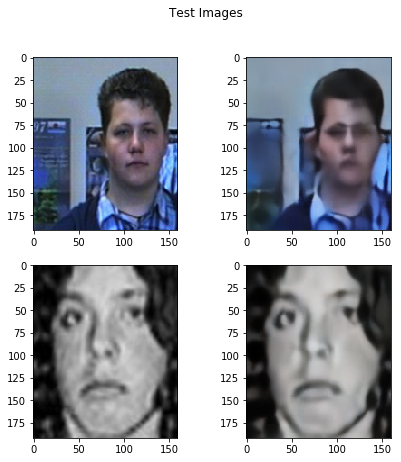

Epoch: 5 Train Loss: 14.873837825492956 Test Loss: 0.6719570371787995
Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

/
Operation completed over 1 objects/294.9 MiB.                                    


In [0]:
train(model, train_loader, optimizer, test_loader=test_loader, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 0 batch 2000 loss: 0.0018137400038540363
	Epoch 0 batch 4000 loss: 0.0016720334533602


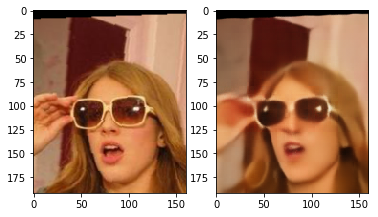

	Epoch 0 batch 6000 loss: 0.0019592212047427893
	Epoch 0 batch 8000 loss: 0.001623710384592414


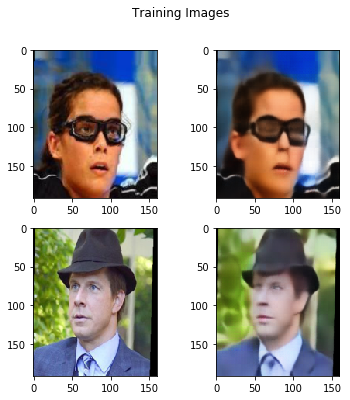

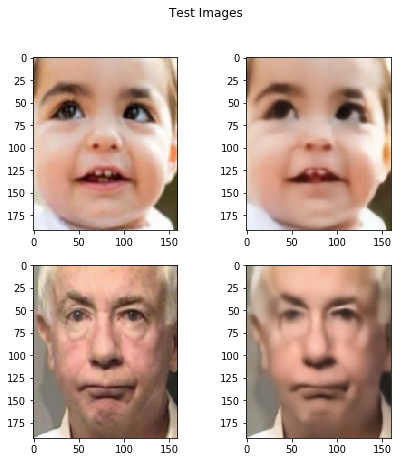

Epoch: 0 Train Loss: 14.863573230803013 Test Loss: 0.6630394199746661
	Epoch 1 batch 2000 loss: 0.0017684705089777708
	Epoch 1 batch 4000 loss: 0.0017425123369321227


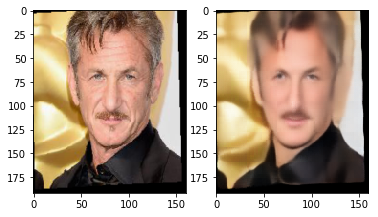

	Epoch 1 batch 6000 loss: 0.001597729860804975
	Epoch 1 batch 8000 loss: 0.0015907688066363335


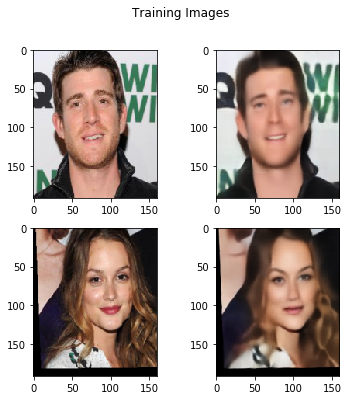

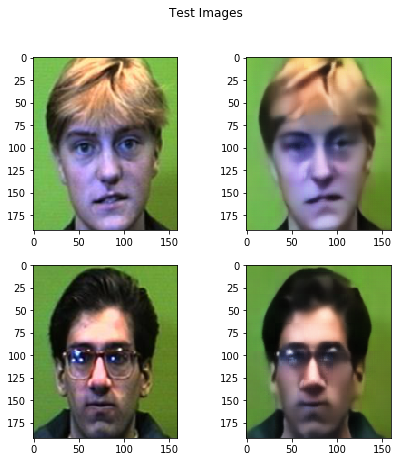

Epoch: 1 Train Loss: 14.819085290888324 Test Loss: 0.668062649667263
	Epoch 2 batch 2000 loss: 0.0016954353777691722
	Epoch 2 batch 4000 loss: 0.0018099372973665595


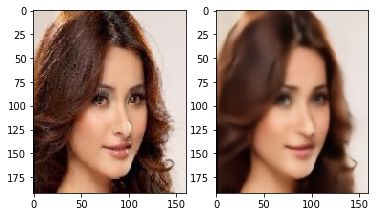

	Epoch 2 batch 6000 loss: 0.0018269849242642522
	Epoch 2 batch 8000 loss: 0.0016200145473703742


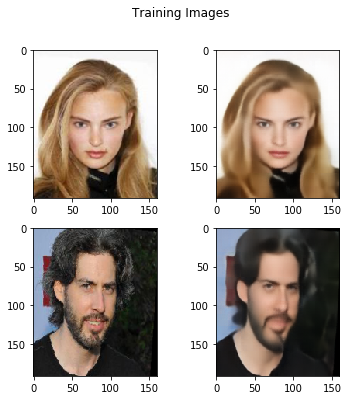

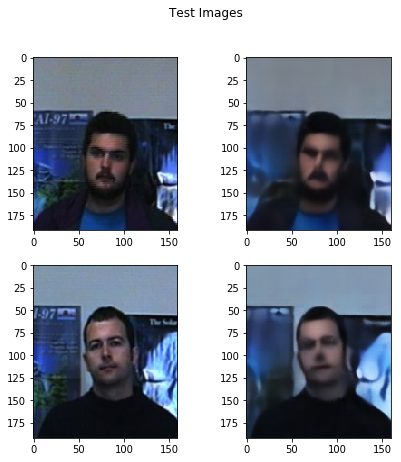

Epoch: 2 Train Loss: 14.782452432671562 Test Loss: 0.6548599264933728
Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

/
Operation completed over 1 objects/294.9 MiB.                                    


In [18]:
train(model, train_loader, optimizer, test_loader=test_loader, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 3 batch 2000 loss: 0.0017487017903476954
	Epoch 3 batch 4000 loss: 0.002017317106947303


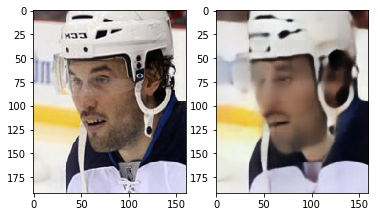

	Epoch 3 batch 6000 loss: 0.001683163340203464
	Epoch 3 batch 8000 loss: 0.0016843219054862857


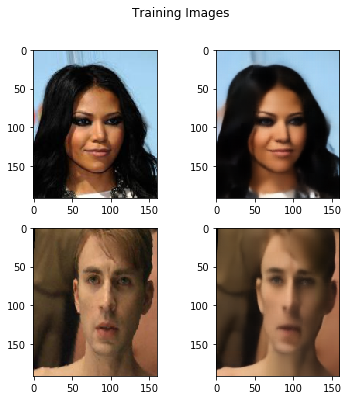

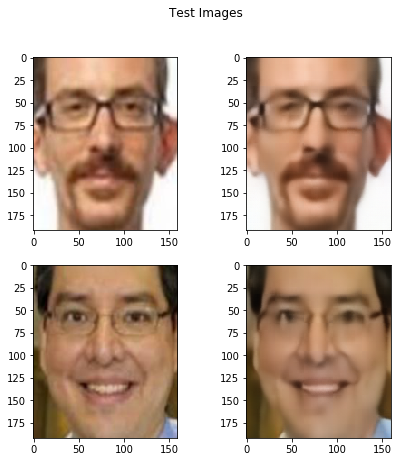

Epoch: 3 Train Loss: 14.744629658875056 Test Loss: 0.6612970520509407
	Epoch 4 batch 2000 loss: 0.0017234632978215814
	Epoch 4 batch 4000 loss: 0.0017355348682031035


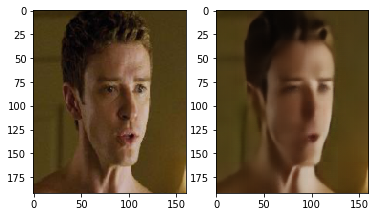

	Epoch 4 batch 6000 loss: 0.0015904792817309499
	Epoch 4 batch 8000 loss: 0.0016814959235489368


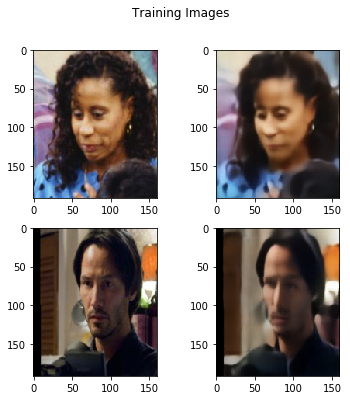

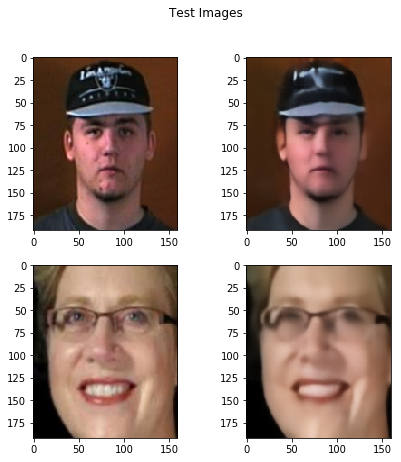

Epoch: 4 Train Loss: 14.710923585807905 Test Loss: 0.6556805404834449
	Epoch 5 batch 2000 loss: 0.0017023097025230527
	Epoch 5 batch 4000 loss: 0.00167101772967726


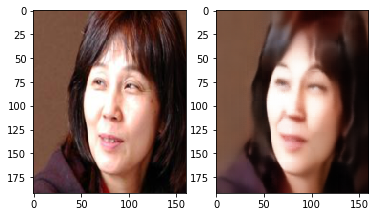

	Epoch 5 batch 6000 loss: 0.001604997436515987
	Epoch 5 batch 8000 loss: 0.0016773351235315204


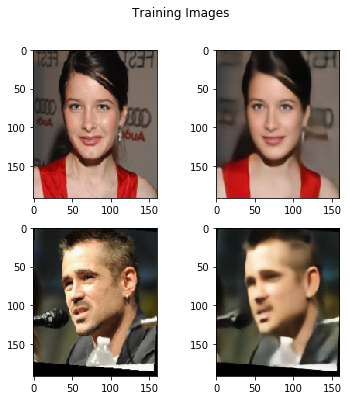

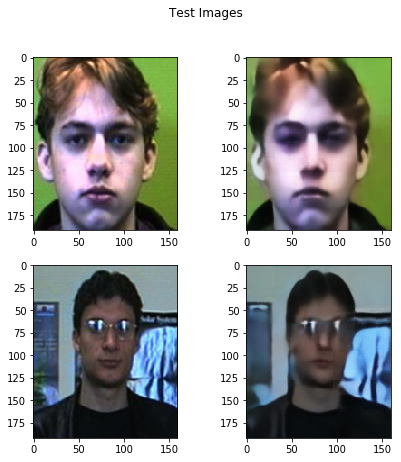

Epoch: 5 Train Loss: 14.671798282419331 Test Loss: 0.6666605977807194
Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

/
Operation completed over 1 objects/294.9 MiB.                                    


In [19]:
train(model, train_loader, optimizer, test_loader=test_loader, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 1 batch 2000 loss: 0.0019186558201909065
	Epoch 1 batch 4000 loss: 0.0018943247850984335


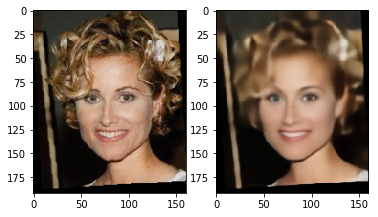

	Epoch 1 batch 6000 loss: 0.0017592672957107425
	Epoch 1 batch 8000 loss: 0.0017337482422590256


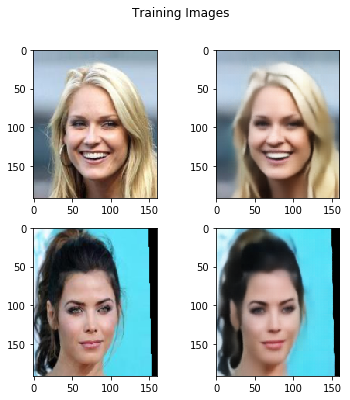

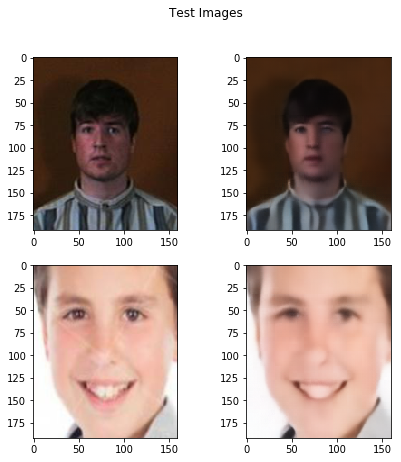

Epoch: 1 Train Loss: 14.638116580666974 Test Loss: 0.6542809082311578
	Epoch 2 batch 2000 loss: 0.0016718024853616953
	Epoch 2 batch 4000 loss: 0.001478812424466014


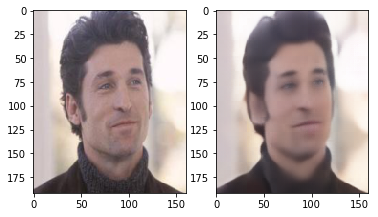

	Epoch 2 batch 6000 loss: 0.0017843591049313545
	Epoch 2 batch 8000 loss: 0.0017882805550470948


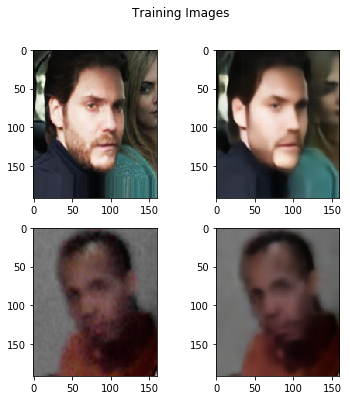

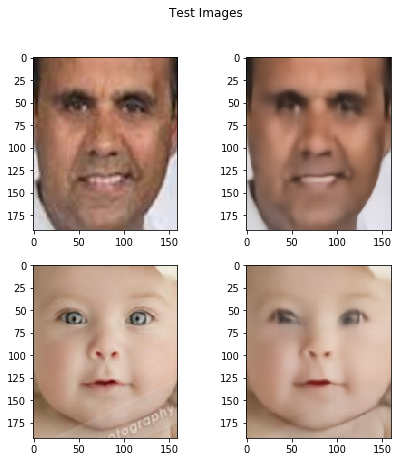

Epoch: 2 Train Loss: 14.612787288380787 Test Loss: 0.6538076850702055
	Epoch 3 batch 2000 loss: 0.0017597939586266875
	Epoch 3 batch 4000 loss: 0.0017086445586755872


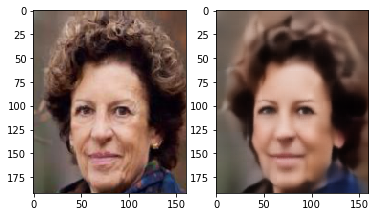

	Epoch 3 batch 6000 loss: 0.0018726321868598461
	Epoch 3 batch 8000 loss: 0.0017141439020633698


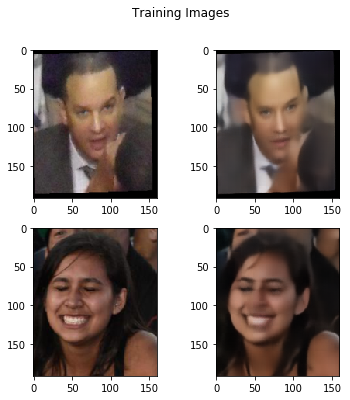

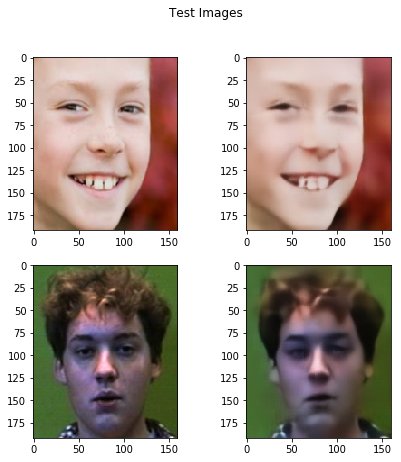

Epoch: 3 Train Loss: 14.579226336907595 Test Loss: 0.6570340660400689
Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

-
Operation completed over 1 objects/294.9 MiB.                                    


In [18]:
train(model, train_loader, optimizer, test_loader=test_loader, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 4 batch 2000 loss: 0.0021726307459175587
	Epoch 4 batch 4000 loss: 0.0015667421976104379


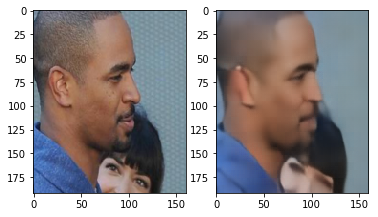

	Epoch 4 batch 6000 loss: 0.0015724766999483109
	Epoch 4 batch 8000 loss: 0.0015855190576985478


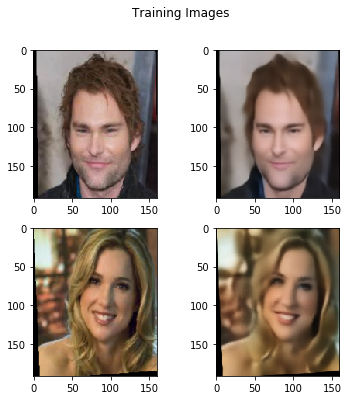

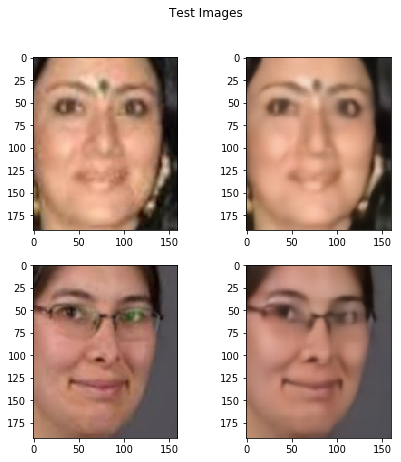

Epoch: 4 Train Loss: 14.551627061679028 Test Loss: 0.6496316760894842
	Epoch 5 batch 2000 loss: 0.0018931706435978413
	Epoch 5 batch 4000 loss: 0.0018503519240766764


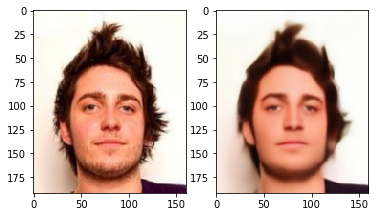

	Epoch 5 batch 6000 loss: 0.0016692776698619127
	Epoch 5 batch 8000 loss: 0.001648911740630865


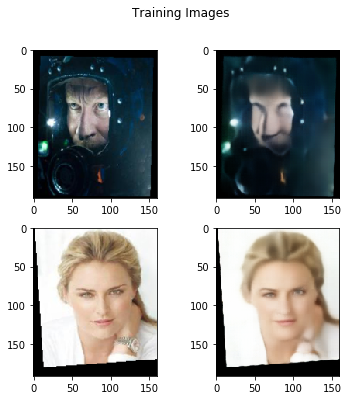

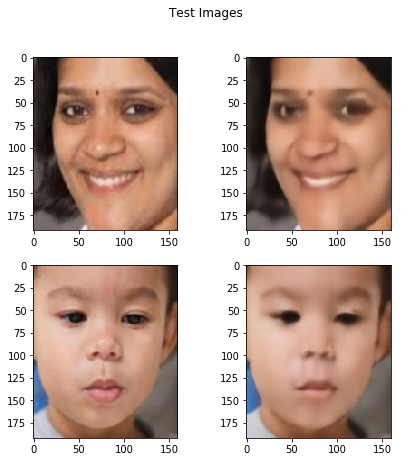

Epoch: 5 Train Loss: 14.520764162065461 Test Loss: 0.6474574722815305
	Epoch 6 batch 2000 loss: 0.0018235325114801526
	Epoch 6 batch 4000 loss: 0.001773045165464282


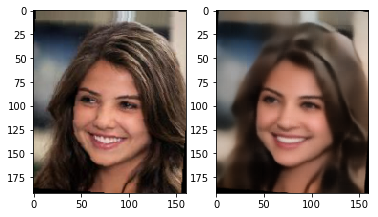

	Epoch 6 batch 6000 loss: 0.0018959932494908571
	Epoch 6 batch 8000 loss: 0.0017709308303892612


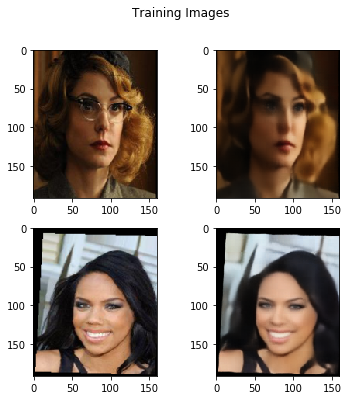

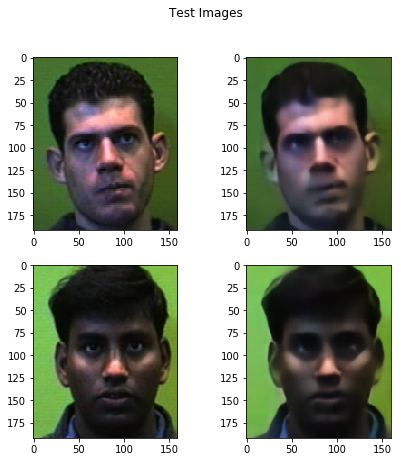

Epoch: 6 Train Loss: 14.489988438319415 Test Loss: 0.6459726586472243
Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

\
Operation completed over 1 objects/294.9 MiB.                                    


In [19]:
train(model, train_loader, optimizer, test_loader=test_loader, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 0 batch 2000 loss: 0.001567059545777738
	Epoch 0 batch 4000 loss: 0.0018859851406887174


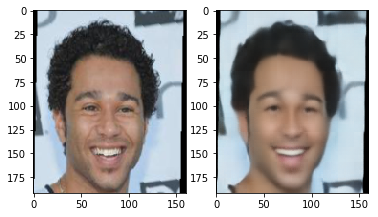

	Epoch 0 batch 6000 loss: 0.001933501334860921
	Epoch 0 batch 8000 loss: 0.0017171563813462853


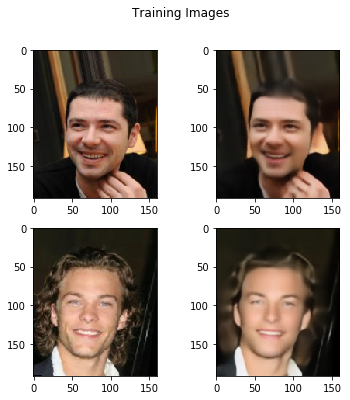

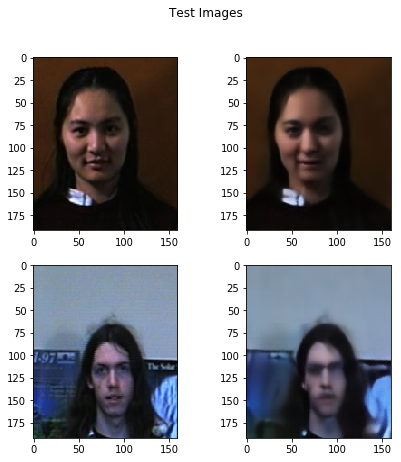

Epoch: 0 Train Loss: 14.384003056678921 Test Loss: 0.6372102309251204
	Epoch 1 batch 2000 loss: 0.001780497725121677
	Epoch 1 batch 4000 loss: 0.00185977213550359


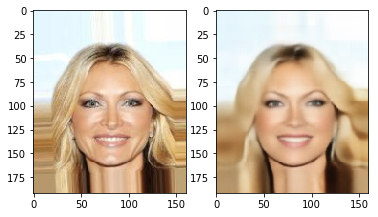

	Epoch 1 batch 6000 loss: 0.0013980100629851222
	Epoch 1 batch 8000 loss: 0.0017394054448232055


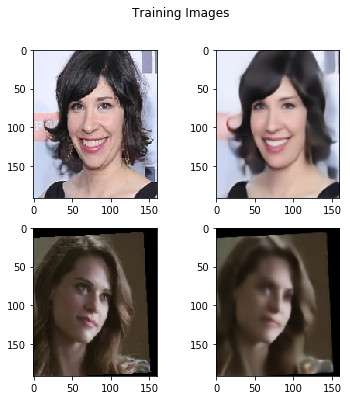

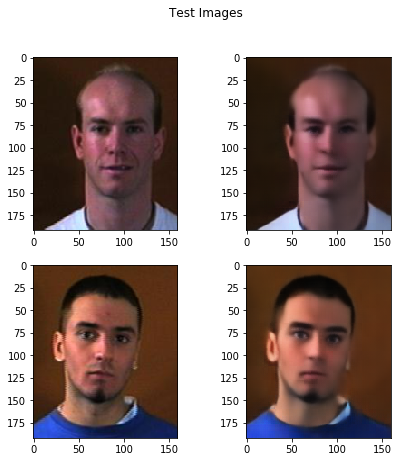

Epoch: 1 Train Loss: 14.361305027734488 Test Loss: 0.6358918762998655
	Epoch 2 batch 2000 loss: 0.0017954477807506919
	Epoch 2 batch 4000 loss: 0.0016882580239325762


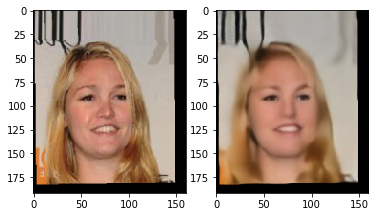

	Epoch 2 batch 6000 loss: 0.001557310577481985
	Epoch 2 batch 8000 loss: 0.001663718605414033


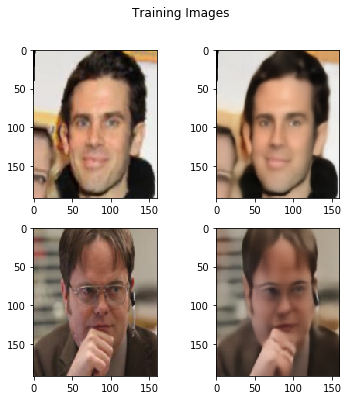

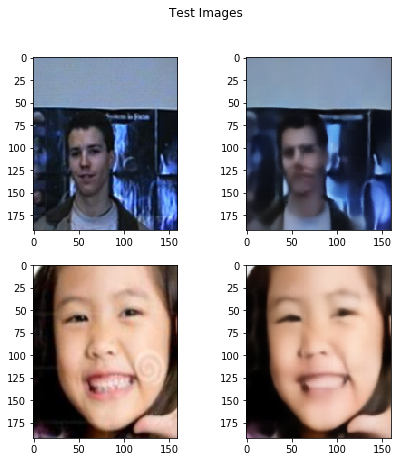

Epoch: 2 Train Loss: 14.333386597805656 Test Loss: 0.6377449233550578
Copying file://model_3.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

/
Operation completed over 1 objects/294.9 MiB.                                    


In [18]:
train(model, train_loader, optimizer, test_loader=test_loader, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

	Epoch 3 batch 2000 loss: 0.0015298216603696346
	Epoch 3 batch 4000 loss: 0.0016081129433587193


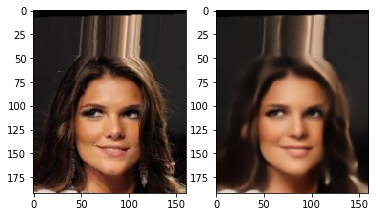

In [0]:
train(model, train_loader, optimizer, test_loader=test_loader, print_metrics=2000, plot_images=5000, num_epochs=3, display_images=1, scheduler=scheduler)

In [0]:
!mkdir data/Train
!cp -r data/images/Training_Pictures data/Train/Images

In [0]:
train_dataset2 = torchvision.datasets.ImageFolder(
        root="data/Train",
        transform=transform
    )

train_loader2 = torch.utils.data.DataLoader(
    train_dataset2,
    batch_size=BATCH_SIZE,
    num_workers=2,
    shuffle=True
)

In [0]:
train(model, train_loader=train_loader2, optimizer=optimizer, print_metrics=10, plot_images=1, num_epochs=25, display_images=1, scheduler=scheduler)

In [0]:
noise = np.random.normal(loc=0.3, scale=7.5, size=4096).reshape((1,4096,1,1))
image = model.decoder(torch.from_numpy(noise).cuda().float())
plt.imshow(image[0].cpu().detach().permute(1,2,0))
plt.show()

In [0]:
# # download and unzip the data
# url = "https://s3.eu-west-3.amazonaws.com/deep.skoo.ch/GWB_64x64.zip"
# if not os.path.exists("gwb_images.zip"):
#   wget.download(url, 'gwb_images.zip')

#   zip_ref = zipfile.ZipFile('gwb_images.zip', 'r')
#   zip_ref.extractall('data/gwb')
#   zip_ref.close()

In [0]:
# use the existing encoder to create a GWBush decoder
from torch import optim
import numpy as np

  ## YOUR CODE HERE ##
encoder = model.encoder
gwb_decoder = Decoder(2048)
gwb_model = SingleModel(encoder, gwb_decoder)
gwb_params = gwb_model.decoder.parameters()

# run on GPU
use_cuda = True

if use_cuda and torch.cuda.is_available():
    encoder.cuda()
    gwb_decoder.cuda()
    gwb_model.cuda()
    
optimizer = optim.Adam(gwb_params, lr=0.002)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)    

In [0]:
# gwb dataset
BATCH_SIZE = 64
data_path = "data/gwb"

transform = torchvision.transforms.Compose(
    [torchvision.transforms.RandomHorizontalFlip(p=0.5), 
      torchvision.transforms.RandomChoice([
        torchvision.transforms.RandomAffine(degrees=7, translate=(0.05,0.05), scale=(0.9,1.1), shear=3, resample=False, fillcolor=0),
        torchvision.transforms.RandomResizedCrop((192,160), scale=(0.90, 1.1)),
      ]),
    torchvision.transforms.ToTensor(),
    ])

gwb_train_dataset = torchvision.datasets.ImageFolder(
        root=data_path,
        transform=transform
    )

gwb_train_loader2 = torch.utils.data.DataLoader(
    gwb_train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True
)

In [0]:
for (images, _) in gwb_train_loader2:
  plt.imshow(images[0].permute(1,2,0))
  break

In [0]:
train(gwb_model, gwb_train_loader2, optimizer, print_metrics=0, num_epochs=200, display_images=20, scheduler=scheduler, save_path="./gwb_model.pt")